# imports

# load data

In [8]:

import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
import tensorflow_probability as tfp
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import pandas as pd
#import data set
import numpy as np
mnist = tf.keras.datasets.mnist
import random
from tensorboard.plugins.hparams import api as hp
import datetime
from tensorflow import keras
from sklearn.model_selection import train_test_split
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()
from sklearn import ensemble
from sklearn import linear_model
import tensorflow as tf
import tensorflow_probability as tfp
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import pandas as pd
#import data set
import numpy as np
mnist = tf.keras.datasets.mnist
import random
from sklearn.model_selection import train_test_split
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()
tfd = tfp.distributions
from photoz_utils import *




import tensorflow as tf
import tensorflow_probability as tfp
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from tensorboard.plugins.hparams import api as hp
import pandas as pd
#import data set
import numpy as np
mnist = tf.keras.datasets.mnist
import random
import datetime
from tensorflow import keras
from sklearn.model_selection import train_test_split
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

#import photoz data:
tfd = tfp.distributions
#from google.colab import files

from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()
#photozdata = pd.read_csv('~/Downloads/forced_forced2_spec_z_matched_online.csv')

#photozdata = pd.read_csv('~/Downloads/forced_forced2_spec_z_matched_online.csv')
#photozdata = pd.read_csv('~/Downloads/trimmed_forced_forced2_spec_z_matched_online.csv')
photozdata = pd.read_csv('/mnt/data/HSC/HSC_v6/HSC_v6.csv')
#photozdata = pd.read_csv('/data/HSC/HSC_IMAGES_FIXED/HSC_photozdata_full_header_trimmed.csv')

print(len(photozdata))
filt = (photozdata['specz_redshift'] < 4)\
& (photozdata['specz_redshift'] > 0.01)\
& (photozdata['specz_redshift_err'] > 0) \
& (photozdata['specz_redshift_err'] < 1)\
&(photozdata["specz_redshift_err"]<0.005*(1+photozdata["specz_redshift"]))\
&(photozdata['g_cmodel_mag'] >0)\
&(photozdata['r_cmodel_mag'] >0)\
&(photozdata['i_cmodel_mag'] >0)\
&(photozdata['z_cmodel_mag'] >0)\
&(photozdata['y_cmodel_mag'] >0)\
&(photozdata['g_cmodel_mag'] < 50)\
&(photozdata['r_cmodel_mag'] < 50)\
&(photozdata['i_cmodel_mag'] < 50)\
&(photozdata['z_cmodel_mag'] < 50)\
&(photozdata['y_cmodel_mag'] < 50)\
&(photozdata['specz_flag_homogeneous'] == True)

photozdata.drop_duplicates(subset=['object_id'])
print(len(photozdata))
photozdata_subset = photozdata[filt]
print(len(photozdata_subset))

photozdata = photozdata_subset
spectro_z = np.asarray(photozdata["specz_redshift"])
col1 = np.asarray(photozdata["g_cmodel_mag"])
col2 = np.asarray(photozdata["r_cmodel_mag"])
col3 = np.asarray(photozdata["i_cmodel_mag"])
col4 =np.asarray(photozdata["z_cmodel_mag"])
col5 = np.asarray(photozdata["y_cmodel_mag"])
specz_err = np.asarray(photozdata["specz_redshift_err"])
gmag_err = np.asarray(photozdata["g_cmodel_magsigma"])
ymag_err = np.asarray(photozdata["y_cmodel_magsigma"])
imag_err = np.asarray(photozdata["i_cmodel_magsigma"])
rmag_err = np.asarray(photozdata["r_cmodel_magsigma"])
zmag_err = np.asarray(photozdata["z_cmodel_magsigma"])

photodata = {'col1':col1,
             'col2':col2,
             'col3':col3,
             'col4':col4,
             'col5':col5,
             'specz_err': specz_err,
             'gmag_err':gmag_err,
             'rmag_err':rmag_err,
            'imag_err':imag_err,
             'zmag_err':zmag_err,
             'ymag_err':ymag_err,
             
             'specz':spectro_z
}


df = pd.DataFrame(photodata)
photodata = df

photodata.replace(-99., np.nan, inplace=True)
photodata.replace(-99.9, np.nan, inplace=True)
photodata.replace(np.inf, np.nan, inplace=True)
photodata= photodata.dropna(how='any')
specz_err = photodata['specz_err']
spectro_z = photodata['specz']
gmag_err = photodata['gmag_err']
ymag_err = photodata['ymag_err']
rmag_err = photodata['rmag_err']
imag_err = photodata['imag_err']
zmag_err = photodata['zmag_err']
photodata = photodata.drop("specz", axis=1)
photodata = photodata.drop("specz_err", axis =1)
photodata = photodata.drop("gmag_err", axis =1)
photodata = photodata.drop("ymag_err", axis =1)

print(len(photodata))

#normalize
photodata = min_max_scaler.fit_transform(photodata)




Num GPUs Available:  1
286401
286401
286401
286401


# figure 1
from https://aurora.astro.ucla.edu/user/ejones/notebooks/look_at_data-visualize_and_plot_galaxy_images.ipynb

In [ ]:
fig4 = plt.figure(constrained_layout=True)
gs = fig4.add_gridspec(12, 12)
f4_ax1 = fig4.add_subplot(gs[0:6, 0:4])
#f4_ax1.sns.displot(spectro_z)
image_file = '/mnt/data/HSC/HSC_v6/y_band_images/y_full/101-cutout-HSC-Y-****-pdr2_wide.fits'
image_data = fits.getdata(image_file, ext=0)
#f4_ax1.figure()
f4_ax1.imshow(image_data, cmap='gray')
#f4_ax1.colorbar()
f4_ax1.set_xlabel('x pixel',fontsize=8)
f4_ax1.set(xticks=[0,60,120],yticks=[0,60,120])
f4_ax1.tick_params(axis='both',which='major',labelsize=6)
f4_ax1.tick_params(axis='both',which='minor',labelsize=4)
f4_ax1.set_ylabel('y pixel',fontsize=8)
# image_file = '/mnt/data/HSC/HSC_v6/y_band_images/y_full/101-cutout-HSC-Y-****-pdr2_wide.fits'
# image_data = fits.getdata(image_file, ext=0)
# plt.figure()
# plt.imshow(image_data, cmap='gray')
# plt.colorbar()

f4_ax2 = fig4.add_subplot(gs[0:6, 4:8])

index = 101
y = [photozdata["g_cmodel_mag"][index],photozdata["r_cmodel_mag"][index],photozdata["i_cmodel_mag"][index],photozdata["z_cmodel_mag"][index],photozdata["y_cmodel_mag"][index]]
x = ['g','r','i','z','y']

f4_ax2.scatter(x,y,s = 12)
f4_ax2.errorbar(x,y,barsabove=True,yerr = [gmag_err[index],rmag_err[index],imag_err[index],zmag_err[index],ymag_err[index]], fmt = 'none')
f4_ax2.set_ylabel('magnitude',fontsize=8)
f4_ax2.set(xticks=['g','r','i','z','y'])#,yticks=[0,60,120])
f4_ax2.tick_params(axis='both',which='major',labelsize=6)
f4_ax2.tick_params(axis='both',which='minor',labelsize=4)
f4_ax2.set_xlabel('band',fontsize=8)


f4_ax3 = fig4.add_subplot(gs[0:6, 8:])
f4_ax3.hist(spectro_z, 1000, facecolor='black', alpha=0.75)
f4_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f4_ax3.set(xticks=[0,1,2,3,4])#,yticks=[0,60,120])
f4_ax3.tick_params(axis='both',which='major',labelsize=6)
f4_ax3.tick_params(axis='both',which='minor',labelsize=4)
f4_ax3.set_ylabel('N(z)',fontsize=8)
fig4.set_dpi(1200)

# figure 2

In [ ]:
#this plot needs to be remade in photoshop. I can ask Bernie for the PS files/talk to Tuan about adjustments to it.

# figure 3

In [ ]:
#not remaking. I think this is a poor graphic. I want to emphasize LSST requirements, not compare to HSC paper.

# figure 4 - COMPARISON TO ALL MODEL BAR CHART

https://aurora.astro.ucla.edu/user/ejones/notebooks/compare%20layers-outliers_and_more_coverage_fill_plots-node%20plots.ipynb



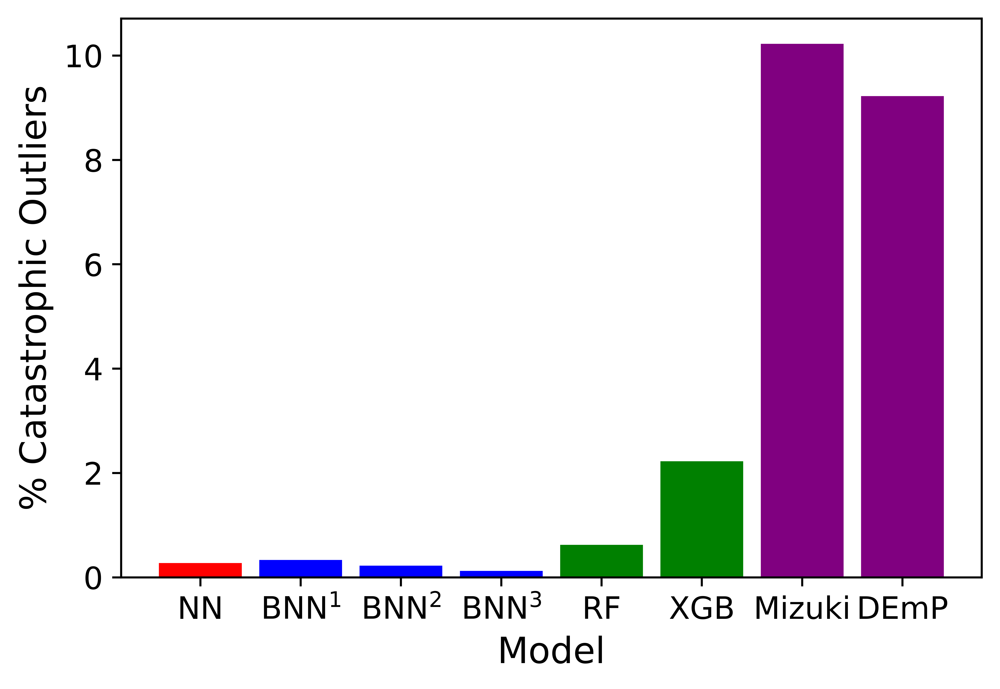

In [311]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
data = [0.25,0.31,0.2,0.1,0.6,2.2,10.2,9.2]

columns = ('NN', 'BNN$^1$', 'BNN$^2$','BNN$^3$', 'RF', 'XGB','Mizuki', 'DEmP')
index = np.arange(len(columns))
bar_width = 0.2
#plt.bar(index, data, bar_width)
barlist = plt.bar(columns,data)
plt.ylabel('% Catastrophic Outliers', fontsize = 14)
plt.xlabel('Model', fontsize=14)
# 
barlist[0].set_color('r')
barlist[1].set_color('b')
barlist[2].set_color('b')
barlist[3].set_color('b')
barlist[4].set_color('g')
barlist[5].set_color('g')
barlist[6].set_color('purple')
barlist[7].set_color('purple')
plt.tick_params(axis='both', which='major', labelsize=12)

# # Plot bars and create text labels for the table
# cell_text = []
# for row in range(n_rows):
#     plt.bar(index, data[row], bar_width, bottom=y_offset, color=colors[row])
#     y_offset = y_offset + data[row]
#     cell_text.append(['%1.1f' % (x / 1000.0) for x in y_offset])
# # Reverse colors and text labels to display the last value at the top.
# colors = colors[::-1]
# cell_text.reverse()

# # Add a table at the bottom of the axes
# the_table = plt.table(cellText=cell_text,
#                       rowLabels=rows,
#                       rowColours=colors,
#                       colLabels=columns,
#                       loc='bottom')

# # Adjust layout to make room for the table:
# plt.subplots_adjust(left=0.2, bottom=0.2)z

# plt.ylabel("Loss in ${0}'s".format(value_increment))
# plt.yticks(values * value_increment, ['%d' % val for val in values])
# plt.xticks([])
# plt.title('Loss by Disaster')

# plt.show()
fig.set_dpi(1200)

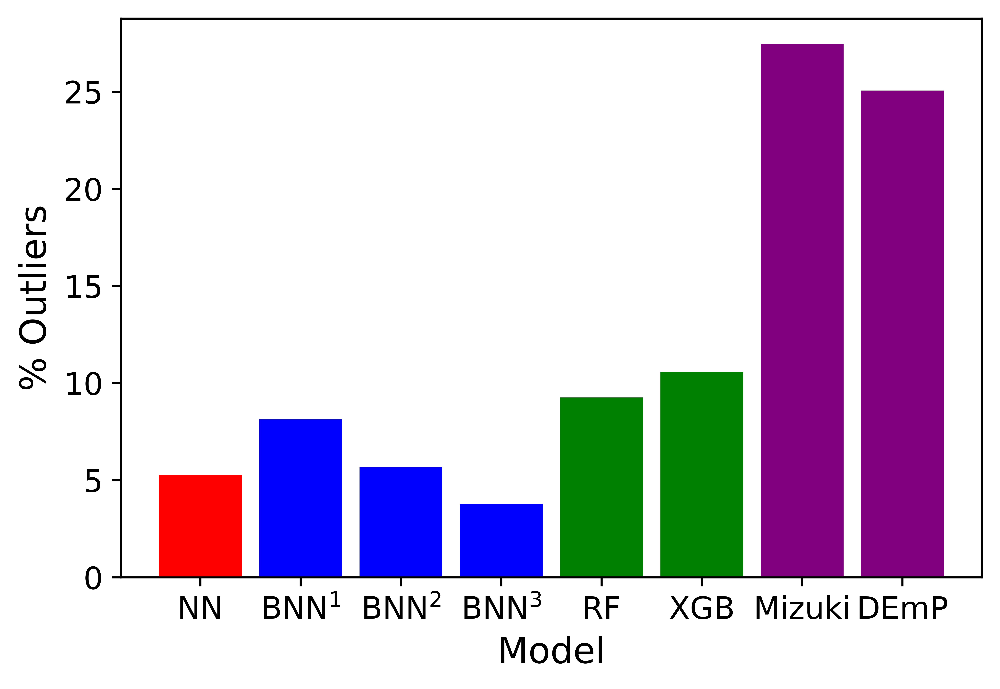

In [302]:
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
data = [5.2,8.07,5.6,3.71,9.2,10.5,27.4,25.0]


columns = ('NN', 'BNN$^1$', 'BNN$^2$','BNN$^3$', 'RF', 'XGB','Mizuki', 'DEmP')
index = np.arange(len(columns))
bar_width = 0.2
#plt.bar(index, data, bar_width)
barlist = plt.bar(columns,data)
plt.ylabel('% Outliers', fontsize = 14)
plt.xlabel('Model', fontsize=14)
# 
barlist[0].set_color('r')
barlist[1].set_color('b')
barlist[2].set_color('b')
barlist[3].set_color('b')
barlist[4].set_color('g')
barlist[5].set_color('g')
barlist[6].set_color('purple')
barlist[7].set_color('purple')
plt.tick_params(axis='both', which='major', labelsize=12)

# # Plot bars and create text labels for the table
# cell_text = []
# for row in range(n_rows):
#     plt.bar(index, data[row], bar_width, bottom=y_offset, color=colors[row])
#     y_offset = y_offset + data[row]
#     cell_text.append(['%1.1f' % (x / 1000.0) for x in y_offset])
# # Reverse colors and text labels to display the last value at the top.
# colors = colors[::-1]
# cell_text.reverse()

# # Add a table at the bottom of the axes
# the_table = plt.table(cellText=cell_text,
#                       rowLabels=rows,
#                       rowColours=colors,
#                       colLabels=columns,
#                       loc='bottom')

# # Adjust layout to make room for the table:
# plt.subplots_adjust(left=0.2, bottom=0.2)

# plt.ylabel("Loss in ${0}'s".format(value_increment))
# plt.yticks(values * value_increment, ['%d' % val for val in values])
# plt.xticks([])
# plt.title('Loss by Disaster')

# plt.show()
fig.set_dpi(1200)

# figure 5 (NEW FIGURE) COMPARING zphot vs z spec plots with outlier cuts
from https://aurora.astro.ucla.edu/user/ejones/notebooks/coverage%20and%20other%20metric%20plots%20after%20zdelta%20cuts.ipynb

<ipython-input-343-f9815338558f>:41: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)


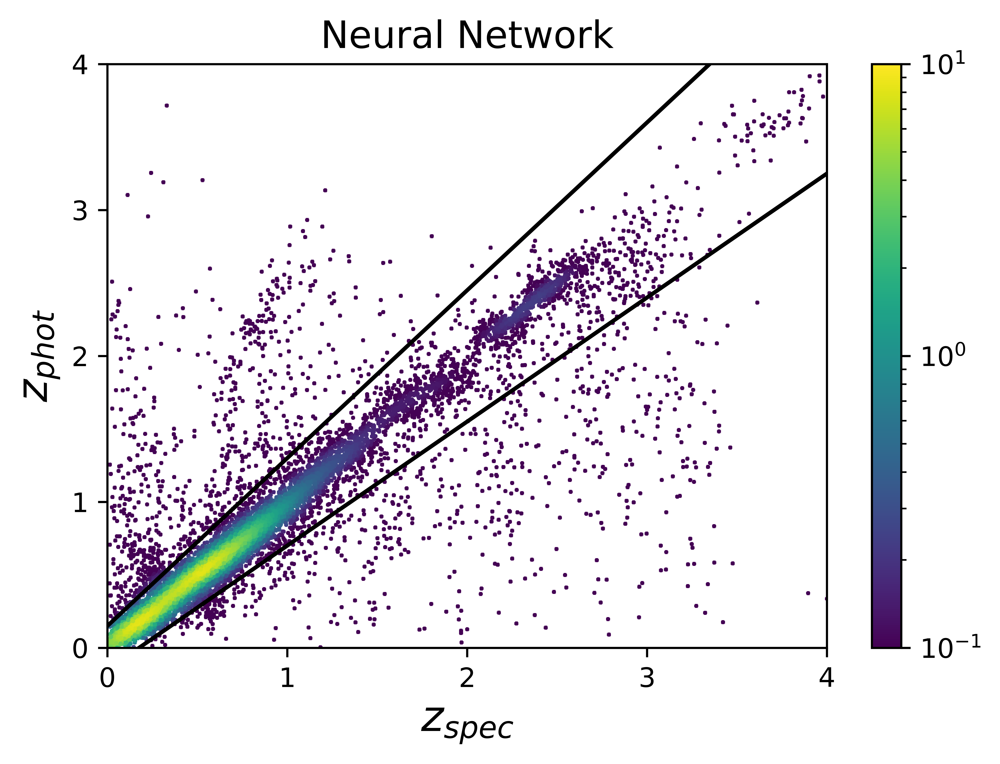

In [343]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import pandas as pd

#goal: after removal of gals with z_delta > 0.5, get indice of remaining:
def get_indice_of_non_cat_outliers(zdelta,zcut):
    
    non_cat_outlier_idx = np.where(zdelta < zcut)
    
    return non_cat_outlier_idx



data_nn = pd.read_csv("nn_best.csv")

# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 100000000

photoz = data_nn['photoz']
#photoz = photoz.str.strip("[]")
photoz1 = np.array(photoz, dtype='float')

zspec = data_nn['spectroz']

ytest1 = zspec



fig, ax = plt.subplots()
x = ytest1

y = np.ravel(photoz1)
#y = photoz
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
plt.title('Neural Network', fontsize = 14)
ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)
#plt.title('Photo-z determination - outliers only')
plt.colorbar(ax_)
# plt.xlabel('spectroscopic redshift')
# plt.ylabel('stdv of ZPDF stdv per gal after 500 determinations')
plt.xlabel('$z_{spec}$',fontsize = 16)
plt.ylabel('$z_{phot}$', fontsize = 16)
plt.plot([.176,4],[0,3.25], color='black')
plt.plot([0, 3.348], [.15, 4],color = 'black')
plt.xticks([0,1,2,3,4])
plt.yticks([0,1,2,3,4])

plt.ylim(0,4)
plt.xlim(0,4)
fig.set_dpi(1200)

plt.show()

In [309]:
ytest1 = np.array(ytest1)
y_test = ytest1

y_test_original = np.array(ytest1)
photoz = photoz1
num_correct = 0
outliers = []
outliers_bayesian = []
outlier_index = []
outlier_index_bayesian = []
cat_outlier_index_bayesian = []
cat_outlier_index = []
bin_size = 0.1
y_test = y_test * bin_size
for i in range(0,len(y_test)):

    if abs(photoz[i] - (y_test[i])) < 0.0001:

        num_correct = num_correct + 1
        
    outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))


    if outliers[i] > 0.15:
            outlier_index.append(i)


    if outliers[i] > 1:
            cat_outlier_index.append(i)
            







print("% correct: ", 100.0*num_correct/len(y_test))
print("number of outliers: ", len(outlier_index), " out of ", len(y_test))
print("% of outliers: ", 100.0*len(outlier_index)/len(y_test))
print("number of catastrophic outliers: ", len(cat_outlier_index), " out of ", len(y_test))
print("% of catastrophic outliers: ", len(cat_outlier_index)/len(y_test))

#calculate RMS error:
RMS_error = np.sqrt(np.sum(((abs(photoz - y_test_original)/(1+y_test_original))**2))/len(y_test))
squares = [x*x for x in outliers]
RMS_error_2 = np.sqrt(np.sum(squares)/len(y_test))
print("RMS error: ", RMS_error_2)

#calculating RMSE another way:
RMSE = mean_squared_error(y_test_original,photoz, squared = False)
print("RMS error = ", RMSE)

####calculate individual galaxy RMS#####
RMS_i = []
ytest1 = np.array(ytest1)
for i in range(0,len(ytest1)):
  rms = abs((photoz1[i]-ytest1[i])/(1+ytest1[i]))
  RMS_i.append(rms**2)


mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)

print("REAL RMS: ", np.sqrt(sum(RMS_i)/len(ytest1)))


% correct:  0.0
number of outliers:  1501  out of  28640
% of outliers:  5.240921787709497
number of catastrophic outliers:  73  out of  28640
% of catastrophic outliers:  0.0025488826815642457
RMS error:  0.12871627365273008
RMS error =  0.24499724170958906
mean individual galaxy RMS 0.016567879103044497
stdev individual galaxy RMS 0.15963108284589228
REAL RMS:  0.1287162736527302


<ipython-input-342-55a4e1dcde27>:41: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)


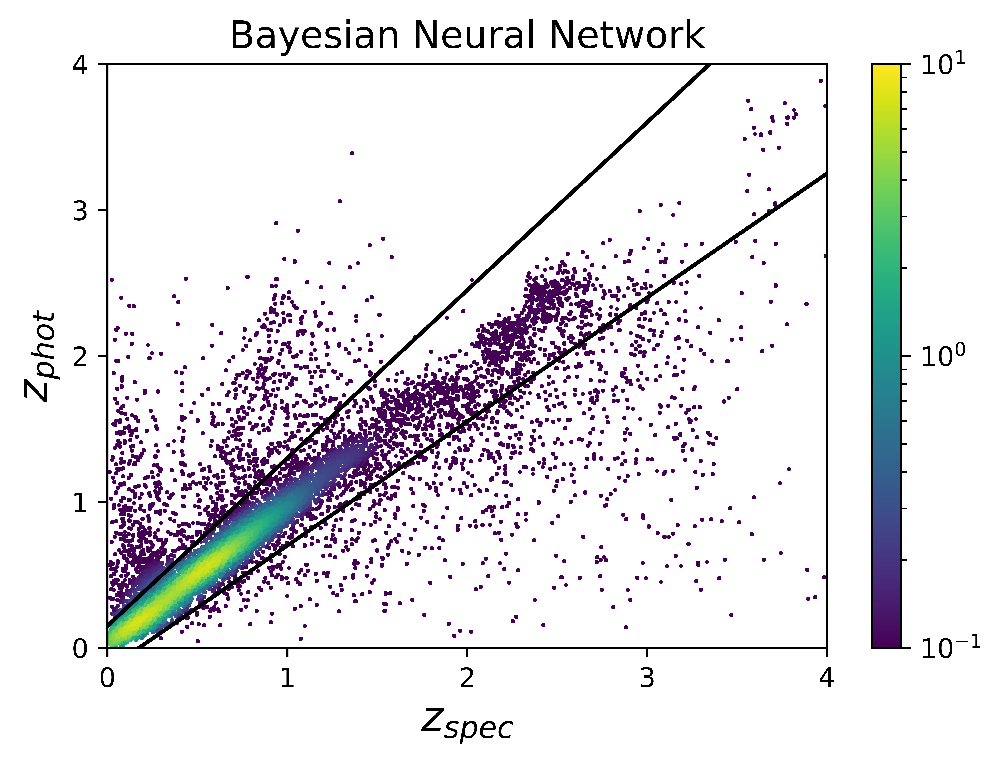

In [342]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import pandas as pd

#goal: after removal of gals with z_delta > 0.5, get indice of remaining:
def get_indice_of_non_cat_outliers(zdelta,zcut):
    
    non_cat_outlier_idx = np.where(zdelta < zcut)
    
    return non_cat_outlier_idx



data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
zdelta = np.array(zdelta, dtype='float')
zcut = 100000000
non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
photoz = photoz.str.strip("[]")
photoz1 = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
zdelta_1 = zdelta[non_cat_outlier_idx]
ytest1 = zspec



fig, ax = plt.subplots()
x = ytest1

y = np.ravel(photoz1)
#y = photoz
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
plt.title('Bayesian Neural Network', fontsize = 14)
ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)
#plt.title('Photo-z determination - outliers only')
plt.colorbar(ax_)
# plt.xlabel('spectroscopic redshift')
# plt.ylabel('stdv of ZPDF stdv per gal after 500 determinations')
plt.xlabel('$z_{spec}$',fontsize = 16)
plt.ylabel('$z_{phot}$', fontsize = 16)
plt.plot([.176,4],[0,3.25], color='black')
plt.plot([0, 3.348], [.15, 4],color = 'black')
plt.xticks([0,1,2,3,4])
plt.yticks([0,1,2,3,4])

plt.ylim(0,4)
plt.xlim(0,4)
fig.set_dpi(1200)

plt.show()


In [ ]:
ytest1 = np.array(ytest1)
y_test = ytest1

y_test_original = np.array(ytest1)
photoz = photoz1
num_correct = 0
outliers = []
outliers_bayesian = []
outlier_index = []
outlier_index_bayesian = []
cat_outlier_index_bayesian = []
cat_outlier_index = []
bin_size = 0.1
y_test = y_test * bin_size
for i in range(0,len(y_test)):

    if abs(photoz[i] - (y_test[i])) < 0.0001:

        num_correct = num_correct + 1
        
    outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
    outliers_bayesian.append((abs(photoz[i] - y_test_original[i]) - zdelta_1[i])/(1+y_test_original[i]))

    if outliers[i] > 0.15:
            outlier_index.append(i)


    if outliers[i] > 1:
            cat_outlier_index.append(i)
            
    if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)


    if outliers_bayesian[i] > 1:
            cat_outlier_index_bayesian.append(i)



print("% correct: ", 100.0*num_correct/len(y_test))
print("number of outliers: ", len(outlier_index), " out of ", len(y_test))
print("% of outliers: ", 100.0*len(outlier_index)/len(y_test))
print("number of catastrophic outliers: ", len(cat_outlier_index), " out of ", len(y_test))
print("% of catastrophic outliers: ", len(cat_outlier_index)/len(y_test))

print("number of bayesian outliers: ", len(outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian outliers: ", 100.0*len(outlier_index_bayesian)/len(y_test))
print("number of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian)/len(y_test))

#calculate RMS error:
RMS_error = np.sqrt(np.sum(((abs(photoz - y_test_original)/(1+y_test_original))**2))/len(y_test))
squares = [x*x for x in outliers]
RMS_error_2 = np.sqrt(np.sum(squares)/len(y_test))
print("RMS error: ", RMS_error_2)

#calculating RMSE another way:
RMSE = mean_squared_error(y_test_original,photoz, squared = False)
print("RMS error = ", RMSE)

####calculate individual galaxy RMS#####
RMS_i = []
ytest1 = np.array(ytest1)
for i in range(0,len(ytest1)):
  rms = abs((photoz1[i]-ytest1[i])/(1+ytest1[i]))
  RMS_i.append(rms**2)


mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)

print("REAL RMS: ", np.sqrt(sum(RMS_i)/len(ytest1)))
bar

In [279]:
RMS_i = []
ytest1 = np.array(ytest1)
for i in range(0,len(ytest1)):
  rms = abs((photoz1[i]-ytest1[i])/(1+ytest1[i]))
  RMS_i.append(rms**2)


mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)

print("REAL RMS: ", np.sqrt(sum(RMS_i)/len(ytest1)))

mean individual galaxy RMS 0.020803350847974213
stdev individual galaxy RMS 0.14278705188516683
REAL RMS:  0.14423366752590802


<ipython-input-344-d2c753746de7>:30: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)


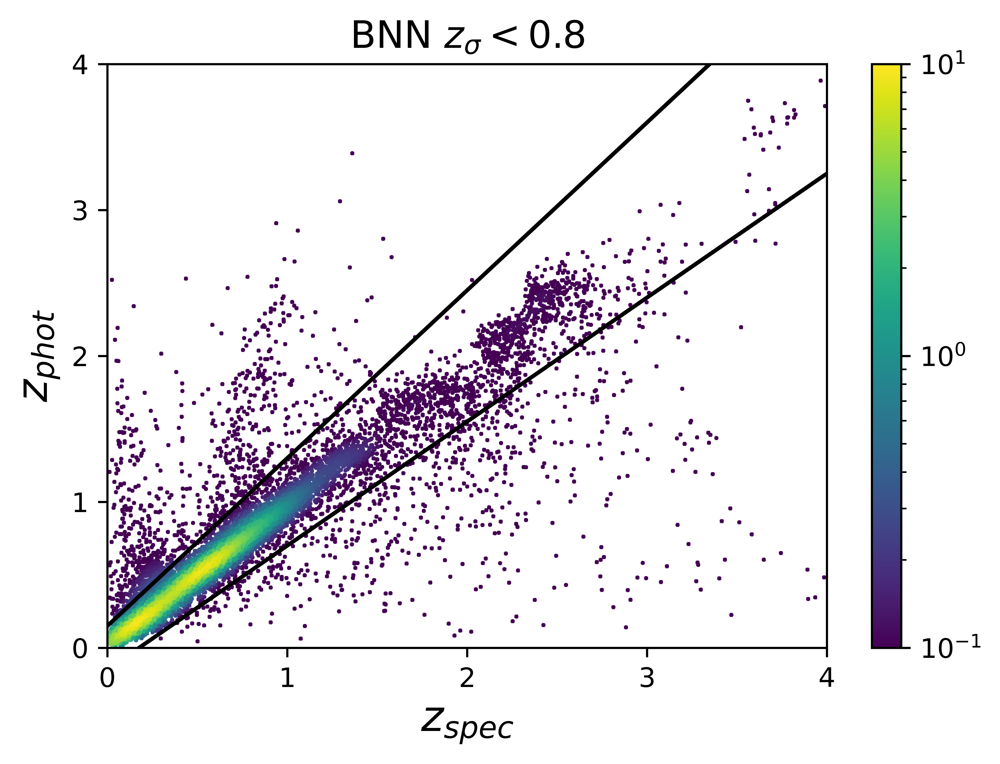

In [344]:

data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
zdelta = np.array(zdelta, dtype='float')
zcut = 0.8
non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
photoz = photoz.str.strip("[]")
photoz1 = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
zdelta_1 = zdelta[non_cat_outlier_idx]
ytest1 = zspec


import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
fig, ax = plt.subplots()
x = ytest1

y = np.ravel(photoz1)
#y = photoz
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)

plt.title('BNN $z_{\sigma} < 0.8$', fontsize = 14)
ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)
#plt.title('Photo-z determination - outliers only')
plt.colorbar(ax_)
# plt.xlabel('spectroscopic redshift')
# plt.ylabel('stdv of ZPDF stdv per gal after 500 determinations')
plt.xlabel('$z_{spec}$',fontsize = 16)
plt.ylabel('$z_{phot}$', fontsize = 16)
plt.plot([.176,4],[0,3.25], color='black')
plt.plot([0, 3.348], [.15, 4],color = 'black')
plt.xticks([0,1,2,3,4])
plt.yticks([0,1,2,3,4])

plt.ylim(0,4)
plt.xlim(0,4)
fig.set_dpi(1200)

plt.show()

In [286]:
ytest1 = np.array(ytest1)
y_test = ytest1

y_test_original = np.array(ytest1)
photoz = photoz1
num_correct = 0
outliers = []
outliers_bayesian = []
outlier_index = []
outlier_index_bayesian = []
cat_outlier_index_bayesian = []
cat_outlier_index = []
bin_size = 0.1
y_test = y_test * bin_size
for i in range(0,len(y_test)):

    if abs(photoz[i] - (y_test[i])) < 0.0001:

        num_correct = num_correct + 1
        
    outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
    outliers_bayesian.append((abs(photoz[i] - y_test_original[i]) - zdelta_1[i])/(1+y_test_original[i]))

    if outliers[i] > 0.15:
            outlier_index.append(i)


    if outliers[i] > 1:
            cat_outlier_index.append(i)
            
    if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)


    if outliers_bayesian[i] > 1:
            cat_outlier_index_bayesian.append(i)



print("% correct: ", 100.0*num_correct/len(y_test))
print("number of outliers: ", len(outlier_index), " out of ", len(y_test))
print("% of outliers: ", 100.0*len(outlier_index)/len(y_test))
print("number of catastrophic outliers: ", len(cat_outlier_index), " out of ", len(y_test))
print("% of catastrophic outliers: ", len(cat_outlier_index)/len(y_test))

print("number of bayesian outliers: ", len(outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian outliers: ", 100.0*len(outlier_index_bayesian)/len(y_test))
print("number of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian)/len(y_test))

#calculate RMS error:
RMS_error = np.sqrt(np.sum(((abs(photoz - y_test_original)/(1+y_test_original))**2))/len(y_test))
squares = [x*x for x in outliers]
RMS_error_2 = np.sqrt(np.sum(squares)/len(y_test))
print("RMS error: ", RMS_error_2)

#calculating RMSE another way:
RMSE = mean_squared_error(y_test_original,photoz, squared = False)
print("RMS error = ", RMSE)

####calculate individual galaxy RMS#####
RMS_i = []
ytest1 = np.array(ytest1)
for i in range(0,len(ytest1)):
  rms = abs((photoz1[i]-ytest1[i])/(1+ytest1[i]))
  RMS_i.append(rms**2)


mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)

print("REAL RMS: ", np.sqrt(sum(RMS_i)/len(ytest1)))


% correct:  0.0
number of outliers:  1575  out of  27734
% of outliers:  5.678950025239778
number of catastrophic outliers:  58  out of  27734
% of catastrophic outliers:  0.0020912958823105215
number of bayesian outliers:  661  out of  27734
% of bayesian outliers:  2.3833561693228527
number of bayesian catastrophic outliers:  20  out of  27734
% of bayesian catastrophic outliers:  0.0007211365111415591
RMS error:  0.11446994794924807
RMS error =  0.22137115102908705
mean individual galaxy RMS 0.013103368983503562
stdev individual galaxy RMS 0.10549420579558454
REAL RMS:  0.11446994794924768


mean individual galaxy RMS 0.013103368983503562
stdev individual galaxy RMS 0.10549420579558454
REAL RMS:  0.11446994794924768


In [260]:
from photoz_utils import *
y_test_new = pd.Series(np.ravel(ytest1))
photoz = pd.Series(np.ravel(photoz1))
get_point_metrics(photoz,y_test_new)

,zspec_bin,count,L,bias_bw,bias_conv,scatter_bw,scatter_conv,outlier_bw,outlier_conv
0,"(0.0, 4.0]",27734,0.089432,0.004286,0.004602,0.031469,0.026124,0.14877,0.05679


In [261]:
len(np.where((abs(photoz - y_test_original) - zdelta_1)/(1+y_test_original) > .15)[0])/len(y_test_original)

ValueError: operands could not be broadcast together with shapes (27734,) (26721,) 

In [ ]:

data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
zdelta = np.array(zdelta, dtype='float')
zcut = 0.5
non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
photoz = photoz.str.strip("[]")
photoz1 = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
zdelta_1 = zdelta[non_cat_outlier_idx]
ytest1 = zspec


import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
fig, ax = plt.subplots()
x = ytest1

y = np.ravel(photoz1)
#y = photoz
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
plt.title('BNN $z_{\sigma} < 0.5$', fontsize = 14)
ax_ = ax.scatter(x,y, marker='+', c = z,s = 1, norm=matplotlib.colors.LogNorm(),vmin=0.1, vmax=10)
#plt.title('Photo-z determination - outliers only')
plt.colorbar(ax_)
# plt.xlabel('spectroscopic redshift')
# plt.ylabel('stdv of ZPDF stdv per gal after 500 determinations')
plt.xlabel('$z_{spec}$',fontsize = 16)
plt.ylabel('$z_{phot}$', fontsize = 16)
plt.plot([.176,4],[0,3.25], color='black')
plt.plot([0, 3.348], [.15, 4],color = 'black')
plt.xticks([0,1,2,3,4])
plt.yticks([0,1,2,3,4])

plt.ylim(0,4)
plt.xlim(0,4)
fig.set_dpi(1200)

plt.show()

In [288]:
ytest1 = np.array(ytest1)
y_test = ytest1

y_test_original = np.array(ytest1)
photoz = photoz1
num_correct = 0
outliers = []
outliers_bayesian = []
outlier_index = []
outlier_index_bayesian = []
cat_outlier_index_bayesian = []
cat_outlier_index = []
bin_size = 0.1
y_test = y_test * bin_size
for i in range(0,len(y_test)):

    if abs(photoz[i] - (y_test[i])) < 0.0001:

        num_correct = num_correct + 1
        
    outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
    outliers_bayesian.append((abs(photoz[i] - y_test_original[i]) - zdelta_1[i])/(1+y_test_original[i]))

    if outliers[i] > 0.15:
            outlier_index.append(i)


    if outliers[i] > 1:
            cat_outlier_index.append(i)
            
    if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)


    if outliers_bayesian[i] > 1:
            cat_outlier_index_bayesian.append(i)



print("% correct: ", 100.0*num_correct/len(y_test))
print("number of outliers: ", len(outlier_index), " out of ", len(y_test))
print("% of outliers: ", 100.0*len(outlier_index)/len(y_test))
print("number of catastrophic outliers: ", len(cat_outlier_index), " out of ", len(y_test))
print("% of catastrophic outliers: ", len(cat_outlier_index)/len(y_test))

print("number of bayesian outliers: ", len(outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian outliers: ", 100.0*len(outlier_index_bayesian)/len(y_test))
print("number of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian)/len(y_test))

#calculate RMS error:
RMS_error = np.sqrt(np.sum(((abs(photoz - y_test_original)/(1+y_test_original))**2))/len(y_test))
squares = [x*x for x in outliers]
RMS_error_2 = np.sqrt(np.sum(squares)/len(y_test))
print("RMS error: ", RMS_error_2)

#calculating RMSE another way:
RMSE = mean_squared_error(y_test_original,photoz, squared = False)
print("RMS error = ", RMSE)

####calculate individual galaxy RMS#####
RMS_i = []
ytest1 = np.array(ytest1)
for i in range(0,len(ytest1)):
  rms = abs((photoz1[i]-ytest1[i])/(1+ytest1[i]))
  RMS_i.append(rms**2)


mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)

print("REAL RMS: ", np.sqrt(sum(RMS_i)/len(ytest1)))


% correct:  0.0
number of outliers:  992  out of  26721
% of outliers:  3.712435911829647
number of catastrophic outliers:  32  out of  26721
% of catastrophic outliers:  0.0011975599715579506
number of bayesian outliers:  496  out of  26721
% of bayesian outliers:  1.8562179559148235
number of bayesian catastrophic outliers:  18  out of  26721
% of bayesian catastrophic outliers:  0.0006736274840013472
RMS error:  0.09077815916000055
RMS error =  0.17446120533041512
mean individual galaxy RMS 0.008240674180478393
stdev individual galaxy RMS 0.0871034695529694
REAL RMS:  0.09077815916000058


In [237]:
len(zdelta)

28640

In [222]:
from photoz_utils import *
y_test_new = pd.Series(np.ravel(ytest1))
photoz = pd.Series(np.ravel(photoz1))
get_point_metrics(photoz,y_test_new)

,zspec_bin,count,L,bias_bw,bias_conv,scatter_bw,scatter_conv,outlier_bw,outlier_conv
0,"(0.0, 4.0]",26721,0.071873,0.004396,0.00466,0.030008,0.024786,0.132592,0.037124


In [282]:
y_test = ytest1
y_test_original = np.array(ytest1)
photoz = photoz1
num_correct = 0
outliers = []
outliers_bayesian = []
outlier_index = []
outlier_index_bayesian = []
cat_outlier_index_bayesian = []
cat_outlier_index = []
bin_size = 0.1
y_test = y_test * bin_size
for i in range(0,len(y_test)):

    if abs(photoz[i] - (y_test[i])) < 0.0001:

        num_correct = num_correct + 1
        
    outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
    outliers_bayesian.append((abs(photoz[i] - y_test_original[i]) - zdelta_1[i])/(1+y_test_original[i]))

    if outliers[i] > 0.15:
            outlier_index.append(i)


    if outliers[i] > 1:
            cat_outlier_index.append(i)
            
    if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)


    if outliers_bayesian[i] > 1:
            cat_outlier_index_bayesian.append(i)



print("% correct: ", 100.0*num_correct/len(y_test))
print("number of outliers: ", len(outlier_index), " out of ", len(y_test))
print("% of outliers: ", 100.0*len(outlier_index)/len(y_test))
print("number of catastrophic outliers: ", len(cat_outlier_index), " out of ", len(y_test))
print("% of catastrophic outliers: ", len(cat_outlier_index)/len(y_test))

print("number of bayesian outliers: ", len(outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian outliers: ", 100.0*len(outlier_index_bayesian)/len(y_test))
print("number of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian), " out of ", len(y_test))
print("% of bayesian catastrophic outliers: ", len(cat_outlier_index_bayesian)/len(y_test))

#calculate RMS error:
RMS_error = np.sqrt(np.sum(((abs(photoz - y_test_original)/(1+y_test_original))**2))/len(y_test))
squares = [x*x for x in outliers]
RMS_error_2 = np.sqrt(np.sum(squares)/len(y_test))
print("RMS error: ", RMS_error_2)

#calculating RMSE another way:
RMSE = mean_squared_error(y_test_original,photoz, squared = False)
print("RMS error = ", RMSE)

####calculate individual galaxy RMS#####
RMS_i = []
for i in range(0,len(y_test)):
  rms = abs((photoz[i]-y_test_original[i])/(1+y_test_original[i]))
  RMS_i.append(rms)

mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)


% correct:  0.0
number of outliers:  992  out of  26721
% of outliers:  3.712435911829647
number of catastrophic outliers:  32  out of  26721
% of catastrophic outliers:  0.0011975599715579506
number of bayesian outliers:  496  out of  26721
% of bayesian outliers:  1.8562179559148235
number of bayesian catastrophic outliers:  18  out of  26721
% of bayesian catastrophic outliers:  0.0006736274840013472
RMS error:  0.09077815916000055
RMS error =  0.17446120533041512
mean individual galaxy RMS 0.03705896375066455
stdev individual galaxy RMS 0.08286921856881072


In [269]:
RMS_i = []
ytest1 = np.array(ytest1)
for i in range(0,len(y_test)):
  rms = abs((photoz[i]-ytest1[i])/(1+ytest1[i]))
  RMS_i.append(rms**2)


mean_rms_i = np.mean(RMS_i)
std_rms_i = np.std(RMS_i)
print("mean individual galaxy RMS", mean_rms_i)
print("stdev individual galaxy RMS", std_rms_i)

print("REAL RMS: ", np.sqrt(sum(RMS_i)/len(ytest1)))

mean individual galaxy RMS 0.020803350847974213
stdev individual galaxy RMS 0.14278705188516683
0.14423366752590802


In [254]:
photoz[453]

0.4772023856639862

In [248]:
photoz

array([0.55948019, 0.64632684, 0.10550996, ..., 0.03864141, 0.56447399,
       0.5610193 ])

In [242]:
len(np.where((abs(photoz - y_test_original) - zdelta_1)/(1+y_test_original) > .15)[0])/len(y_test_original)

0.018562179559148236

In [ ]:
zdel

In [229]:
zdelta

array([0.02029752, 0.02639031, 0.03447072, ..., 0.01566735, 0.04542819,
       0.02093061])

In [54]:
zspec

0        0.52815
1        0.58830
2        0.06299
3        0.38062
4        0.19152
          ...   
28635    0.52727
28636    0.45877
28637    0.01767
28638    0.55751
28639    0.58560
Name: spectroz, Length: 28640, dtype: float64

# figure 6

In [57]:
data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
zdelta = np.array(zdelta, dtype='float')
zcut = 1000
photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz= np.array(photoz, dtype='float')
zspec = data_bnn['spectroz']
prediction_stdv = zdelta
y_test = zspec
y_test_original = y_test
num_correct = 0
outliers = []
outliers_bayesian = []
outlier_index = []
outlier_index_bayesian = []
cat_outlier_index_bayesian = []
cat_outlier_index = []
#y_test = y_test * bin_size
for i in range(0,len(y_test)):

    if abs(photoz[i] - (y_test[i])) < 0.0001:

        num_correct = num_correct + 1
        
    outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
    outliers_bayesian.append((abs(photoz[i] - y_test_original[i]) - prediction_stdv[i])/(1+y_test_original[i]))

    if outliers[i] > 0.15:
            outlier_index.append(i)


    if outliers[i] > 1:
            cat_outlier_index.append(i)
            
    if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)


    if outliers_bayesian[i] > 1:
            cat_outlier_index_bayesian.append(i)

In [58]:
#this shows that by simply eye balling a cutoff in the below plot (0.5), i can eliminate 99% of catastrophic outliers with a 10% acccuracy)
#now I should plot the outliers cut vs non-outliers cut as a function of photo-z uncertainty cutoff:

non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
zdelta = zdelta[non_cat_outlier_idx]
count = 0
cat_count = 0
non_cat_outliers_removed = []
cat_outliers_removed = []
non_outliers_removed = []
outliers_removed = []
photoz_uncertainty_cutoff = []
gals_removed = []
outliers_remaining = []
cat_outliers_remaining = []
outliers_removed_count = 0
cat_outliers_removed_count = 0


for g in range(0,21):
    count = 0
    cat_count = 0
    outlier_count = 0
    for i in range(len(zdelta)):
        if zdelta[i] >g/10.0:
            count = count+1

            for j in range(0, len(cat_outlier_index)):
                if i == cat_outlier_index[j]:
                    cat_count = cat_count + 1
                   
            for p in range(0, len(outlier_index)):
                if i == outlier_index[p]:
                    outlier_count = outlier_count + 1
                  
                    
    non_cat_outliers_removed.append(count-cat_count)
    cat_outliers_removed.append(cat_count)
    non_outliers_removed.append(count-outlier_count)
    gals_removed.append(count)
    outliers_removed.append(outlier_count)
    photoz_uncertainty_cutoff.append(g/10.0)
    outliers_remaining.append(len(outlier_index)-outlier_count)
    cat_outliers_remaining.append(len(cat_outlier_index)-cat_count)

In [62]:
#figure 6

#FROM 

#https://aurora.astro.ucla.edu/user/ejones/notebooks/coverage%20and%20other%20metric%20plots%20after%20zdelta%20cuts.ipynb

#this shows that by simply eye balling a cutoff in the below plot (0.5), i can eliminate 99% of catastrophic outliers with a 10% acccuracy)
#now I should plot the outliers cut vs non-outliers cut as a function of photo-z uncertainty cutoff:



count = 0
cat_count = 0
non_cat_outliers_removed = []
cat_outliers_removed = []
non_outliers_removed = []
outliers_removed = []
photoz_uncertainty_cutoff = []
gals_removed = []
outliers_remaining = []
cat_outliers_remaining = []
outliers_removed_count = 0
cat_outliers_removed_count = 0


for g in range(0,21):
    count = 0
    cat_count = 0
    outlier_count = 0
    for i in range(len(zdelta)):
        if zdelta[i] >g/10.0:
            count = count+1

            for j in range(0, len(cat_outlier_index)):
                if i == cat_outlier_index[j]:
                    cat_count = cat_count + 1
                   
            for p in range(0, len(outlier_index)):
                if i == outlier_index[p]:
                    outlier_count = outlier_count + 1
                  
                    
    non_cat_outliers_removed.append(count-cat_count)
    cat_outliers_removed.append(cat_count)
    non_outliers_removed.append(count-outlier_count)
    gals_removed.append(count)
    outliers_removed.append(outlier_count)
    photoz_uncertainty_cutoff.append(g/10.0)
    outliers_remaining.append(len(outlier_index)-outlier_count)
    cat_outliers_remaining.append(len(cat_outlier_index)-cat_count)
    


In [204]:
fig3 = plt.figure(figsize =(12,24))
gs = fig3.add_gridspec(4, 1 )
f3_ax1 = fig3.add_subplot(gs[0, 0])
f3_ax2 = fig3.add_subplot(gs[1, 0])
f3_ax3 = fig3.add_subplot(gs[2,0])
f3_ax4 = fig3.add_subplot(gs[3, 0])


f3_ax1.set(xticks=[], yticks =[0,2,4,6,8,10])
#f3_ax1.set_aspect('auto')
f3_ax2.set(xticks=[], yticks = [0,20,40,60,80,100])
f3_ax3.set(xticks=[], yticks = [0,20,40,60,80,100])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0], yticks = [0.0,20,40,60,80,100])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_remaining)/len(y_test)))
f3_ax1.set_ylabel('O remaining (%)',fontsize=11)
#f3_ax1.set(yticks=[0,20,30,40,50])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=9)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_outliers_removed)/(len(y_test)-len(outlier_index))))
f3_ax2.set_ylabel('$non-O$ removed (%)',fontsize=11)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=9)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/(len(outlier_index))))
f3_ax3.set_ylabel('$O$ removed (%)',fontsize=11)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


#f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal accuracy (%)',fontsize=9)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$',fontsize=14)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1200) 

In [180]:
gs[0:2]

GridSpec(24, 12)[0:1, 0:2]

In [173]:
(100*np.array(outliers_remaining)/len(y_test))

array([0.        , 0.82053073, 1.66201117, 2.17527933, 2.78631285,
       3.46368715, 4.10614525, 4.84287709, 5.49930168, 6.21857542,
       6.7527933 , 7.17527933, 7.47555866, 7.67458101, 7.82472067,
       7.91899441, 7.96089385, 7.99231844, 8.00628492, 8.02723464,
       8.02723464])

In [290]:
fig3 = plt.figure(figsize =(8,12))
gs = fig3.add_gridspec(24, 12)
f3_ax1 = fig3.add_subplot(gs[0:6, 0:12])
f3_ax2 = fig3.add_subplot(gs[6:12, 0:12])
f3_ax3 = fig3.add_subplot(gs[12:18,0:12])
f3_ax4 = fig3.add_subplot(gs[18:24, 0:12])


f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_remaining)/len(y_test)))
f3_ax1.set_ylabel('$O_c$ \nremaining (%)',fontsize=16)
#f3_ax1.set(yticks=[0,20,30,40,50])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=11)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_cat_outliers_removed)/(len(y_test)-len(cat_outlier_index))))
f3_ax2.set_ylabel('non-$O_c$ \nremoved (%)',fontsize=16)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=12)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_removed)/(len(cat_outlier_index))))
f3_ax3.set_ylabel('$O_c$ \nremoved (%)',fontsize=16)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal \naccuracy (%)',fontsize=16)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$ cutoff',fontsize=18)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1200) 

In [219]:
fig3 = plt.figure(figsize =(8,12))
gs = fig3.add_gridspec(24, 12)
f3_ax1 = fig3.add_subplot(gs[0:6, 0:12])
f3_ax2 = fig3.add_subplot(gs[6:12, 0:12])
f3_ax3 = fig3.add_subplot(gs[12:18,0:12])
f3_ax4 = fig3.add_subplot(gs[18:24, 0:12])


f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_remaining)/len(y_test)))
f3_ax1.set_ylabel('O \nremaining (%)',fontsize=16)
#f3_ax1.set(yticks=[0,20,30,40,50])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=11)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_outliers_removed)/(len(y_test)-len(outlier_index))))
f3_ax2.set_ylabel('non-O \nremoved (%)',fontsize=16)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=12)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/(len(outlier_index))))
f3_ax3.set_ylabel('O \nremoved (%)',fontsize=16)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal \naccuracy (%)',fontsize=16)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$ cutoff',fontsize=18)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1200) 

In [289]:
fig3 = plt.figure(figsize =(6,10))
gs = fig3.add_gridspec(24, 12)
#f3_ax1 = fig3.add_subplot(gs[0:6, 0:12])
f3_ax2 = fig3.add_subplot(gs[0:8, 0:12])
f3_ax3 = fig3.add_subplot(gs[8:16,0:12])
f3_ax4 = fig3.add_subplot(gs[16:24, 0:12])


#f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
# #f3_ax1.set_title('Bayesian', fontsize = 9)
# f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_remaining)/len(y_test)))
# f3_ax1.set_ylabel('CO remaining (%)',fontsize=11)
#f3_ax1.set(yticks=[0,20,30,40,50])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=11)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_cat_outliers_removed)/(len(y_test)-len(cat_outlier_index))))
f3_ax2.set_ylabel('non-$O_c$ removed (%)',fontsize=11)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=12)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_removed)/(len(cat_outlier_index))))
f3_ax3.set_ylabel('$O_c$ removed (%)',fontsize=11)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('$O_c$ removal accuracy (%)',fontsize=11)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$',fontsize=14)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1200) 

In [165]:
(100*np.array(cat_outliers_remaining)/len(y_test))

array([0.        , 0.00698324, 0.02793296, 0.04539106, 0.07332402,
       0.11173184, 0.14315642, 0.17108939, 0.20251397, 0.23393855,
       0.26536313, 0.27932961, 0.30726257, 0.33170391, 0.34916201,
       0.35963687, 0.37011173, 0.37011173, 0.37011173, 0.37360335,
       0.37360335])

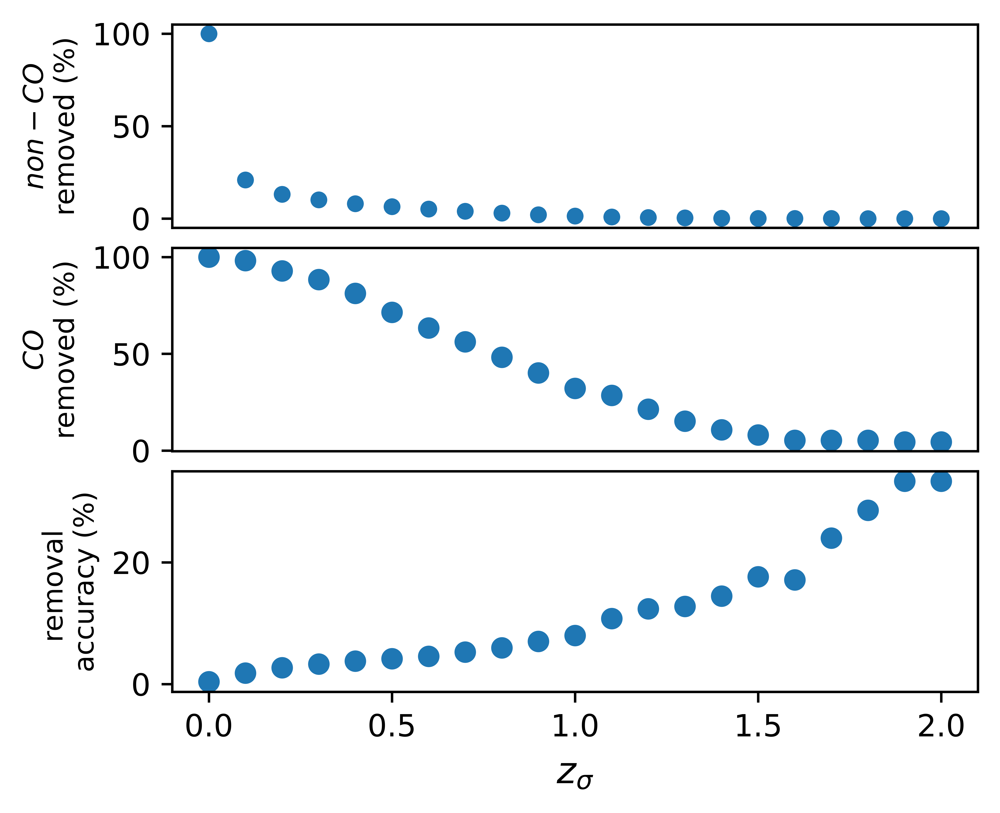

In [160]:
fig3 = plt.figure(constrained_layout=False)
import matplotlib.gridspec as gridspec
gs = fig3.add_gridspec(39, 14)
#gs = gridspec.GridSpec(ncols = 1, nrows = 4, figure = fig3)

f3_ax2 = fig3.add_subplot(gs[0:12, 0:11])
f3_ax3 = fig3.add_subplot(gs[13:25,0:11])
f3_ax4 = fig3.add_subplot(gs[26:39, 0:11])

#f3_ax1.tick_params(axis='both', which='minor', labelsize=8)
#f3_ax1.set_yticklabels([0,20,40,60,80],fontsize=6)
# f3_ax2.set_yticklabels([0,20,40,60,80],fontsize=9)
# f3_ax3.set_yticklabels([0,20,40,60,80],fontsize=9)
# f3_ax4.set_yticklabels([0,20,40,60,80],fontsize=9)
#f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
# f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_remaining)/len(y_test)))
# f3_ax1.set_ylabel('CO remaining (%)',fontsize=5)
# f3_ax1.set(yticks = [0,0.2,0.4,0.6,0.8,1.0])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=11)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_cat_outliers_removed)/(len(y_test)-len(cat_outlier_index))), s = 20)
f3_ax2.set_ylabel('$non-CO$ \nremoved (%)',fontsize=9)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=12)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_removed)/(len(cat_outlier_index))))
f3_ax3.set_ylabel('$CO$ \nremoved (%)',fontsize=9)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(cat_outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal \naccuracy (%)',fontsize=9)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$',fontsize=12)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1200) 

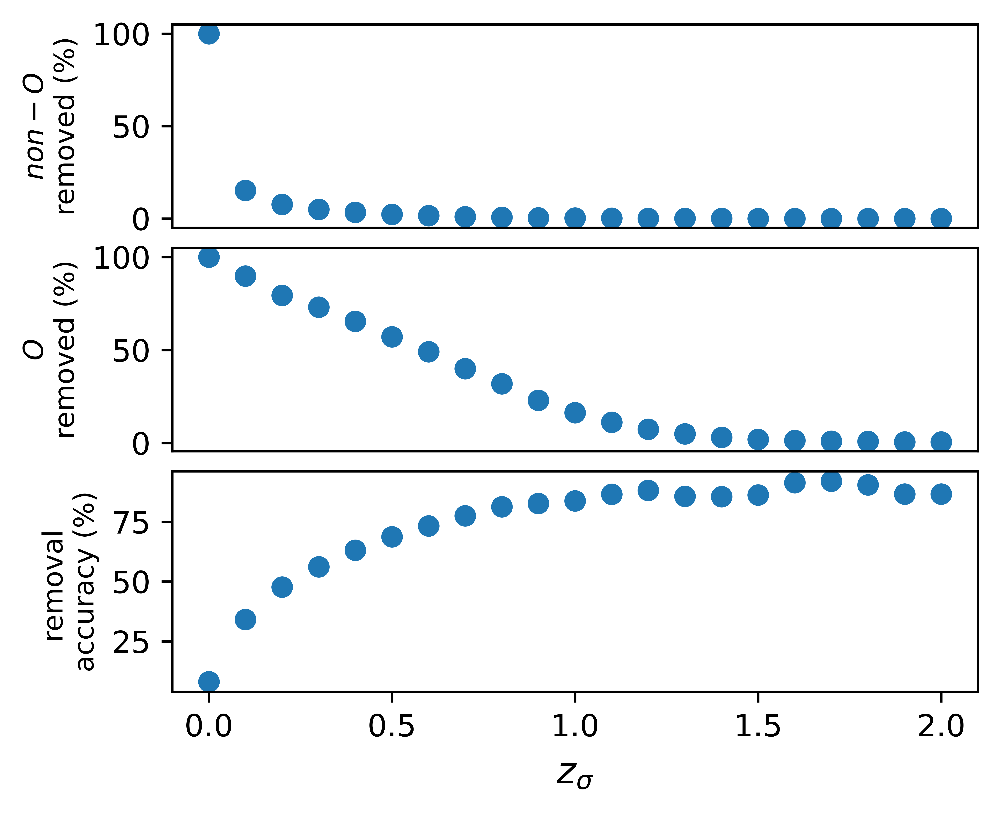

In [157]:
fig3 = plt.figure(constrained_layout=False)
import matplotlib.gridspec as gridspec
gs = fig3.add_gridspec(39, 14)
#gs = gridspec.GridSpec(ncols = 1, nrows = 4, figure = fig3)

f3_ax2 = fig3.add_subplot(gs[0:12, 0:11])
f3_ax3 = fig3.add_subplot(gs[13:25,0:11])
f3_ax4 = fig3.add_subplot(gs[26:39, 0:11])

#f3_ax1.tick_params(axis='both', which='minor', labelsize=8)
#f3_ax1.set_yticklabels([0,20,40,60,80],fontsize=6)
# f3_ax2.set_yticklabels([0,20,40,60,80],fontsize=9)
# f3_ax3.set_yticklabels([0,20,40,60,80],fontsize=9)
# f3_ax4.set_yticklabels([0,20,40,60,80],fontsize=9)
#f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
# f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_remaining)/len(y_test)))
# f3_ax1.set_ylabel('O remaining (%)',fontsize=5)
# f3_ax1.set(yticks = [0,0.2,0.4,0.6,0.8,1.0])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=11)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_outliers_removed)/(len(y_test)-len(outlier_index))))
f3_ax2.set_ylabel('$non-O$ \nremoved (%)',fontsize=9)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=12)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/(len(outlier_index))))
f3_ax3.set_ylabel('$O$ \nremoved (%)',fontsize=9)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal \naccuracy (%)',fontsize=9)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$',fontsize=12)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1200) 

In [148]:
 len((100*np.array(cat_outliers_removed)/np.array(gals_removed)))

21

In [130]:
fig3 = plt.figure(constrained_layout=True)
gs = fig3.add_gridspec(26, 13)
f3_ax1 = fig3.add_subplot(gs[0:6, 0:11])
f3_ax2 = fig3.add_subplot(gs[6:12, 0:11])
f3_ax3 = fig3.add_subplot(gs[12:18,0:11])
f3_ax4 = fig3.add_subplot(gs[18:24, 0:11])


f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax1.tick_params(axis='both', which='minor', labelsize=8)

f3_ax2.tick_params(axis='both', which='minor', labelsize=8)

f3_ax3.tick_params(axis='both', which='minor', labelsize=8)

f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_remaining)/len(y_test)))
f3_ax1.set_ylabel('O remaining (%)',fontsize=11)
#f3_ax1.set(yticks=[0,20,30,40,50])
#f3_ax1.tick_params(axis='both',which='major',labelsize=6)
#f3_ax1.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax2.set_ylabel('metrics',fontsize=9)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_outliers_removed)/(len(y_test)-len(outlier_index))))
f3_ax2.set_ylabel('$non-O$ removed (%)',fontsize=11)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=9)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/(len(outlier_index))))
f3_ax3.set_ylabel('$O$ removed (%)',fontsize=11)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


#f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal accuracy (%)',fontsize=9)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$',fontsize=14)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1800) 

In [136]:
fig3 = plt.figure(constrained_layout=True)
gs = fig3.add_gridspec(24, 13)
#f3_ax1 = fig3.add_subplot(gs[0:6, 0:11])
f3_ax2 = fig3.add_subplot(gs[0:8, 0:11])
f3_ax3 = fig3.add_subplot(gs[8:16,0:11])
f3_ax4 = fig3.add_subplot(gs[16:24, 0:11])


#f3_ax1.set(xticks=[])
f3_ax2.set(xticks=[])
f3_ax3.set(xticks=[])
f3_ax4.set(xticks=[0.0,0.5,1.0,1.5,2.0])
#f3_ax4.set_xticklabels(['0','0.5','1.0','1.5','2.0'])
#f3_ax1.set_title('Bayesian', fontsize = 9)
# f3_ax1.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_remaining)/len(y_test)))
# f3_ax1.set_ylabel('O remaining (%)',fontsize=11)
#f3_ax1.set(yticks=[0,20,30,40,50])
f3_ax1.tick_params(axis='both',which='major',labelsize=6)

f3_ax1.tick_params(axis='both',which='minor',labelsize=4)
f3_ax1.set_yticklabels([0,20,40], fontsize=5)
#f3_ax2.set_ylabel('metrics',fontsize=9)
f3_ax2.scatter(photoz_uncertainty_cutoff, (100*np.array(non_outliers_removed)/(len(y_test)-len(outlier_index))))
f3_ax2.set_ylabel('$non-O$ \n removed (%)',fontsize=11)
#f3_ax2.legend(prop={'size': 6})
#f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
#f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
#f3_ax2.tick_params(axis='both',which='major',labelsize=6)
#f3_ax2.tick_params(axis='both',which='minor',labelsize=4)

#f3_ax3.set_ylabel('metrics',fontsize=9)
f3_ax3.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/(len(outlier_index))))
f3_ax3.set_ylabel('$O$ \nremoved (%)',fontsize=11)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
#f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
#f3_ax3.tick_params(axis='both',which='major',labelsize=6)
#f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
#f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)


#f3_ax4.set_ylabel('metrics',fontsize=9)
f3_ax4.scatter(photoz_uncertainty_cutoff, (100*np.array(outliers_removed)/np.array(gals_removed)))
f3_ax4.set_ylabel('removal \naccuracy (%)',fontsize=11)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax4.set_xlabel('$z_{\sigma}$',fontsize=12)#f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)

fig3.set_dpi(1800) 

<ipython-input-136-41706735ca72>:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  f3_ax1.set_yticklabels([0,20,40], fontsize=5)


In [28]:
import pandas as pd
import numpy as np
data_bcnn2 = pd.read_csv('bnn_v5_best.csv')
zdelta = data_bcnn2['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bcnn2 = np.ravel(np.array(zdelta, dtype='float'))
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
photoz = data_bcnn2['photoz']
photoz = photoz.str.strip("[]")
photoz_cbnn2 = np.array(photoz, dtype='float')

zspec = data_bcnn2['spectroz']
specz_bcnn2 = zspec

def calc_coverage(z_phot,z_spec,z_delta):
#calc coverage:
    abs_diff = abs(z_phot - z_spec)
    coverage = len(np.where(abs_diff < z_delta)[0])/len(z_spec)
    return coverage
def calc_coverage2(z_phot,z_spec,z_delta):
    num_within = 0
    for i in range(len(z_phot)):
            if abs(z_phot[i] - z_spec[i]) < z_delta[i]:
                num_within = num_within+1
            
    coverage = num_within/len(z_phot)
    print("coverage is ", coverage)
    

In [24]:

import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
import tensorflow_probability as tfp
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import pandas as pd
#import data set
import numpy as np
mnist = tf.keras.datasets.mnist
import random
from tensorboard.plugins.hparams import api as hp
import datetime
from tensorflow import keras
from sklearn.model_selection import train_test_split
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()
from sklearn import ensemble

from sklearn import linear_model
import tensorflow as tf
import tensorflow_probability as tfp
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import pandas as pd
#import data set
import numpy as np
mnist = tf.keras.datasets.mnist
import random
from sklearn.model_selection import train_test_split
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()
tfd = tfp.distributions
from photoz_utils import *

gpus = tf.config.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only allocate 1GB of memory on the first GPU
  try:
    tf.config.experimental.set_virtual_device_configuration(
        gpus[0],
        [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=5000)])
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Virtual devices must be set before GPUs have been initialized
    print(e)



import tensorflow as tf
import tensorflow_probability as tfp
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from tensorboard.plugins.hparams import api as hp
import pandas as pd
#import data set
import numpy as np
mnist = tf.keras.datasets.mnist
import random
import datetime
from tensorflow import keras
from sklearn.model_selection import train_test_split
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

#import photoz data:
tfd = tfp.distributions
#from google.colab import files

from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()
#photozdata = pd.read_csv('~/Downloads/forced_forced2_spec_z_matched_online.csv')


def calculate_biweight_outlier_rate(z_photo,z_spec,b_bw,sigma_bw):
    
# The biweight outlier rate defined in HSC DPR2 paper. 

    delz = (z_photo - z_spec)/(1+z_spec)
    number_outlier = len(np.where(abs(delz-b_bw)>2*sigma_bw)[0])
    outlier_rate_conv = number_outlier/len(z_photo)
    return outlier_rate_conv


def calculate_PIT(predictions,true_value):

# predictions is a two dimentional array. Each row is a PDF for the estimation of redshift for a galaxy. 
# y_test is an array containing the true_value of redshift for all the galaxies. 
# the ouput of this function is a PIT distribution for all the PDFs. 

    PIT  = np.zeros(len(predictions))
    
    for i in range (len(predictions)):          
        PIT[i] = len(np.where(predictions[i]<true_value[i])[0])*1.0/len(predictions[0])
        
    return PIT

def calculate_3sigma_outliers(z_photo,z_spec,stdv):

# This function calculate the conventional outlier rate. 


   

    delz = (z_photo - z_spec)
    number_outlier = len(np.where(abs(delz)/stdv>3)[0])
    outlier_rate = number_outlier/len(z_photo)
    return outlier_rate


def calculate_HSC_outlier_rate(z_photo,z_spec):

# This function calculate the conventional outlier rate. 


   

    delz = (z_photo - z_spec)
    number_outlier = len(np.where(abs(delz)>0.15)[0])
    outlier_rate_HSC = number_outlier/len(z_photo)
    return outlier_rate_HSC


def calculate_delta_z_div_z_err(z_photo, z_spec, z_err):
    delta_z = abs(z_photo - z_spec)
    delta_z_div_z_err = delta_z / z_err

    
    return np.mean(delta_z_div_z_err), np.median(delta_z_div_z_err)


def calculate_bayesian_outlier_rate(z_photo,z_spec,z_err):

#     #outliers_bayesian.append((abs(photoz[i] - y_test_original[i]) - prediction_stdv[i][0])/(1+y_test_original[i]))
#     print("len z err: ", len(z_err))
#     print("max z err: ", max(z_err))
#     print("len z phot: ", len(z_photo))
#     print("len z spec: ", len(z_spec))
    
#     print(z_err)
#     z_photo = np.array(z_photo)
#     z_spec = np.array(z_spec)
#     z_err = np.array(z_err)
#     delz = (abs(z_photo - z_spec) - z_err)/(1+z_spec)
    
#     print("len delz: ", len(delz))
#     number_outlier = len(np.where(delz>0.15)[0])
#     print("number_outlier: ", number_outlier)
#     bayesian_outlier_rate = number_outlier/len(z_photo)
    outliers_bayesian = []
    outlier_index_bayesian = []
    for i in range(0,len(z_spec)):


        #outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
        outliers_bayesian.append((abs(z_photo[i] - z_spec[i]) - z_err[i][0])/(1+z_spec[i]))
        if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)
    
    bayesian_outlier_rate = len(outlier_index_bayesian)/len(z_spec)
    
    return bayesian_outlier_rate

def calculate_conv_outlier_rate(z_photo,z_spec):

# This function calculate the conventional outlier rate. 


    #outliers.append(abs(photoz[i] - y_test_original[i])/(1+y_test_original[i]))

    delz = (z_photo - z_spec)/(1+z_spec)
    number_outlier = len(np.where(abs(delz)>0.15)[0])
    outlier_rate_conv = number_outlier/len(z_photo)
    return outlier_rate_conv

def calculate_cat_conv_outlier_rate(z_photo,z_spec):

# This function calculate the conventional outlier rate. 


    #outliers.append(abs(photoz[i] - y_test_original[i])/(1+y_test_original[i]))

    delz = (z_photo - z_spec)
    number_outlier = len(np.where(abs(delz)>1)[0])
    cat_outlier_rate_conv = number_outlier/len(z_photo)
    return cat_outlier_rate_conv

def calculate_conv_outlier_rate2(z_photo,z_spec):

# This function calculate the conventional outlier rate. 


    outliers_bayesian = []
    outlier_index_bayesian = []
    for i in range(0,len(z_spec)):


        #outliers.append((abs(photoz[i] - y_test_original[i]))/(1+y_test_original[i]))
        outliers_bayesian.append((abs(z_photo[i] - z_spec[i]))/(1+z_spec[i]))
        if outliers_bayesian[i] > 0.15:
            outlier_index_bayesian.append(i)
    
    outlier_rate_conv = len(outlier_index_bayesian)/len(z_spec)
    
    return outlier_rate_conv

def calculate_z_diff_div_phot_err_rate(z_photo,z_spec,z_err):

    z_diff_div_phot_err_rate = (z_photo - z_spec)/z_err

    return z_diff_div_phot_err_rate


from photoz_utils import *

#y_test = y_test_original
def calculate_bias_LSST(z_photo, z_spec, conventional=False):
    """
    HSC METRIC. Returns a single value. Bias is a measure of center of the
    distribution of prediction errors.

    z_photo: array
        Photometric or predicted redshifts.
    z_spec: array
        Spectroscopic or actual redshifts.
    conventional: bool
        Whether to use the conventional bias or not. If true, use conventional
        bias, or the median of the errors. If false, use the biweight bias, or
        the biweight location of the errors.
    """
    dz =(z_photo-z_spec)/(1+z_spec)
    dz = np.mean(dz)
    return dz


# b_LSST = calculate_bias_LSST(y_test_predict,y_test, True)

# b_bw = calculate_bias(y_test_predict,y_test)
# sigma_bw = calculate_scatter(y_test_predict,y_test)
# outlier_rate = calculate_biweight_outlier_rate(y_test_predict,y_test,b_bw,sigma_bw)
# loss_function = calculate_loss(y_test_predict,y_test)
# conv_outlier_rate = calculate_conv_outlier_rate2(y_test_predict,y_test)

# cat_outlier_rate = calculate_cat_conv_outlier_rate(z_photo,z_spec)
# average_loss = sum(loss_function)/len(loss_function)

# HSC_outlier_rate = calculate_HSC_outlier_rate(y_test_predict,y_test)
    

# print ("bias: %s"%(b_bw))
# print ("bias for LSST: %s"%(b_LSST))

# print("scatter: %s"%(sigma_bw))
# print("biweighht outlier rate: %s"%(outlier_rate))
# print("cat outlier rate: %s"%(cat_outlier_rate))
# print("conventional outlier rate: %s"%(conv_outlier_rate))

# print("HSC outlier rate: %s"%(HSC_outlier_rate))
# print("average loss: %s"%(average_loss))

Num GPUs Available:  1
1 Physical GPUs, 1 Logical GPUs


In [378]:

data_cnn = pd.read_csv("/predictions/HSC_v6_CNNTrials_5_pooling_2x2_filters_doubled_v3/testing_predictions_big.csv")
photoz_cnn = data_cnn['photoz']
specz_cnn = data_cnn['specz']

#full bcnn
data_bcnn = pd.read_csv("billy_bcnn_2.csv")
photoz_bcnn = data_bcnn['photoz']
photoz_err_bcnn = data_bcnn['photoz_err']
specz_bcnn = data_bcnn['specz']


data_nn = pd.read_csv("4layers_200_nodes_NN_1.header.csv")
photoz_nn = data_nn['photoz']
photoz_nn = np.array(photoz_nn.str.strip("[]"),dtype='float')
#photoz_err_nn = data_bcnn['photoz_err']
specz_nn = data_nn['spectroz']


data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bnn = np.array(zdelta, dtype='float')

photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz_bnn = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz']
specz_bnn = np.array(zspec)

zcut = 0.8
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma8 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma8 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma8 = photoz_err_bnn[non_cat_outlier_idx]

zcut = 0.5
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma5 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma5 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma5 = photoz_err_bnn[non_cat_outlier_idx]



# #now 3 sigma outliers:

# #Now bias

# #to obtain these plots, plot the average of the curves +- the standard deviation at each bin

#data_bnn = pd.read_csv("4layers_200_nodes.header.csv")

# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# photoz_err_bnn = np.array(zdelta, dtype='float')
# # zcut = 1000
# # non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz_bnn = np.array(photoz, dtype='float')

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# specz_bnn = zspec
# fourlayer_coverage_1 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_1 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('1layers_200_nodes.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000

# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz2 = np.array(photoz, dtype='float')
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest2 = zspec
# fourlayer_coverage_2 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_2 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_3.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz3 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest3 = zspec
# fourlayer_coverage_3 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_3 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_4.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz4 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest4 = zspec
# fourlayer_coverage_4 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_4 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_5.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest5 = zspec
# fourlayer_coverage_5 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_5 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz5 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_6.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest6 = zspec
# fourlayer_coverage_6 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_6 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz6 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_7.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz7 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest7 = zspec
# fourlayer_coverage_7 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_7 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_8.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest8 = zspec
# fourlayer_coverage_8 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_8 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz8 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_9.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz9 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest9 = zspec
# fourlayer_coverage_9 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_9 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_10.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest10 = zspec
# fourlayer_coverage_10 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_10 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz10 = np.array(photoz, dtype='float')


from photoz_utils import *
#ytest_predict = zspec
#z_err = specz_err[idx_test]
#z_err = np.array(prediction_stdv)
#max_z_err = max(z_err)
#ytest = ytest_original
coverage_arr = []
fig, ax = plt.subplots()

biweight_outlier_rate_arr = []
conv_outlier_arr = []
b_bw_arr = []
sigma_bw_arr = []
loss_arr = []
hsc_outlier_arr = []
delta_z_div_z_err_arr = []
median_delta_z_div_z_err_arr = []
# final_per_gal_coverage_1 = np.array(fourlayer_coverage_1/68.27)
# final_per_gal_coverage_2 = np.array(fourlayer_coverage_2/68.27)
# final_per_gal_coverage_3 = np.array(fourlayer_coverage_3/68.27)
# final_per_gal_coverage_4 = np.array(fourlayer_coverage_4/68.27)
# final_per_gal_coverage_5 = np.array(fourlayer_coverage_5/68.27)
# final_per_gal_coverage_6 = np.array(fourlayer_coverage_6/68.27)
# final_per_gal_coverage_7 = np.array(fourlayer_coverage_7/68.27)
# final_per_gal_coverage_8 = np.array(fourlayer_coverage_8/68.27)
# final_per_gal_coverage_9 = np.array(fourlayer_coverage_9/68.27)
# final_per_gal_coverage_10 = np.array(fourlayer_coverage_10/68.27)

coverage_1_arr = []
coverage_2_arr = []
coverage_3_arr = []
coverage_4_arr = []
coverage_5_arr = []
coverage_6_arr = []
coverage_7_arr = []
coverage_8_arr = []
coverage_9_arr = []
coverage_10_arr = []

outlier_1_bnn = []
outlier_1_bnn_sigma8 = []
outlier_1_bnn_sigma5 = []
outlier_1_nn = []

bias_2_arr = []
bias_3_arr = []
bias_4_arr = []
bias_5_arr = []
bias_6_arr = []
bias_7_arr = []
bias_8_arr = []
bias_9_arr = []
bias_10_arr = []

ytest = specz_bcnn

            



            
for i in range(0,26):
    
            filt_bnn = (specz_bnn > i/10.0)\
            & (specz_bnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bnn_i = photoz_bnn[filt_bnn]
            ytest_bnn_i = specz_bnn[filt_bnn]
            outlier_1_bnn.append(calculate_conv_outlier_rate(photoz_bnn_i,ytest_bnn_i))

            ytest = specz_bnn
            
for i in range(0,26):
    
            filt_bnn_sigma8 = (specz_bnn_sigma8 > i/10.0)\
            & (specz_bnn_sigma8 < (i+1) / 10.0)

            
            photoz_bnn_sigma8_i = photoz_bnn_sigma8[filt_bnn_sigma8]
            ytest_bnn_sigma8_i = specz_bnn_sigma8[filt_bnn_sigma8]
            photoz_err_bnn_sigma8_i = photoz_err_bnn_sigma8[filt_bnn_sigma8]

            outlier_1_bnn_sigma8.append(calculate_conv_outlier_rate(photoz_bnn_sigma8_i,ytest_bnn_sigma8_i,))


for i in range(0,26):
    
            filt_bnn_sigma5 = (specz_bnn_sigma5 > i/10.0)\
            & (specz_bnn_sigma5 < (i+1) / 10.0)

            
            photoz_bnn_sigma5_i = photoz_bnn_sigma5[filt_bnn_sigma5]
            ytest_bnn_sigma5_i = specz_bnn_sigma5[filt_bnn_sigma5]
            photoz_err_bnn_sigma5_i = photoz_err_bnn_sigma5[filt_bnn_sigma5]

            outlier_1_bnn_sigma5.append(calculate_conv_outlier_rate(photoz_bnn_sigma5_i,ytest_bnn_sigma5_i,))


for i in range(0,26):
    
            filt_nn = (specz_nn > i/10.0)\
            & (specz_nn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_nn_i = photoz_nn[filt_nn]
            ytest_nn_i = specz_nn[filt_nn]
            outlier_1_nn.append(calculate_conv_outlier_rate(photoz_nn_i,ytest_nn_i))

            ytest = specz_nn
            

                
#         if j == 2:
#             filt = (ytest2 > i/10.0)\
#             & (ytest2 < (i+2) / 10.0)
# #             coverage_2 = np.mean(final_per_gal_coverage_2[filt])
# #             coverage_2_arr.append(coverage_2)
#             photoz_i = photoz2[filt]
#             ytest_i = ytest2[filt]
#             bias_2_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
            
            
#         if j == 3:
#             filt = (ytest3 > i/10.0)\
#             & (ytest3 < (i+3) / 10.0)
# #             coverage_3 = np.mean(final_per_gal_coverage_3[filt])
# #             coverage_3_arr.append(coverage_3)
#             photoz_i = photoz3[filt]
#             ytest_i = ytest3[filt]
#             bias_3_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 4:
#             filt = (ytest4 > i/10.0)\
#             & (ytest4 < (i+4) / 10.0)
# #             coverage_4 = np.mean(final_per_gal_coverage_4[filt])
# #             coverage_4_arr.append(coverage_4)
#             photoz_i = photoz4[filt]
#             ytest_i = ytest4[filt]
#             bias_4_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 5:
#             filt = (ytest5 > i/10.0)\
#             & (ytest5 < (i+5) / 10.0)
# #             coverage_5 = np.mean(final_per_gal_coverage_5[filt])
# #             coverage_5_arr.append(coverage_5)
#             photoz_i = photoz5[filt]
#             ytest_i = ytest5[filt]
#             bias_5_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 6:
#             filt = (ytest6 > i/10.0)\
#             & (ytest6 < (i+6) / 10.0)
# #             coverage_6 = np.mean(final_per_gal_coverage_6[filt])
# #             coverage_6_arr.append(coverage_6)
#             photoz_i = photoz6[filt]
#             ytest_i = ytest6[filt]
#             bias_6_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 7:
#             filt = (ytest7 > i/10.0)\
#             & (ytest7 < (i+7) / 10.0)
# #             coverage_7 = np.mean(final_per_gal_coverage_7[filt])
# #             coverage_7_arr.append(coverage_7)   
#             photoz_i = photoz7[filt]
#             ytest_i = ytest7[filt]
#             bias_7_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 8:
#             filt = (ytest8 > i/10.0)\
#             & (ytest8 < (i+8) / 10.0)
# #             coverage_8 = np.mean(final_per_gal_coverage_8[filt])
# #             coverage_8_arr.append(coverage_8)
#             photoz_i = photoz8[filt]
#             ytest_i = ytest8[filt]
#             bias_8_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         #photoz_i = ytest_predict[filt]
#         #ytest_i = ytest[filt]
#         #z_err_i = z_err[filt]


#         if j == 9:
#             filt = (ytest9 > i/10.0)\
#             & (ytest9 < (i+9) / 10.0)
# #             coverage_9 = np.mean(final_per_gal_coverage_9[filt])
# #             coverage_9_arr.append(coverage_9)    
#             photoz_i = photoz9[filt]
#             ytest_i = ytest9[filt]
#             bias_9_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 10:
#             filt = (ytest10 > i/10.0)\
#             & (ytest10 < (i+10) / 10.0)
# #             coverage_10 = np.mean(final_per_gal_coverage_10[filt])
# #             coverage_10_arr.append(coverage_10)
#             photoz_i = photoz10[filt]
#             ytest_i = ytest10[filt]
#             bias_10_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))            
            
      #b_bw = calculate_conv_outlier_rate(photoz_i,ytest_i,fourlayer_zddu_1)
#     sigma_bw = calculate_scatter(photoz_i,ytest_i)
#     outlier_rate = calculate_biweight_outlier_rate(photoz_i,ytest_i,b_bw,sigma_bw)
#     loss_function = calculate_loss(photoz_i,ytest_i)
#     conv_outlier_rate = calculate_conv_outlier_rate(photoz_i,ytest_i)
#     HSC_outlier_rate = calculate_HSC_outlier_rate(photoz_i,ytest_i)
#     delta_z_div_z_err, median_delta_z_div_z_err = calculate_delta_z_div_z_err(photoz_i, ytest_i, z_err_i)
    
#     coverage_2 = np.mean(final_per_gal_coverage_2[filt])
#     coverage_3 = np.mean(final_per_gal_coverage_3[filt])
#     coverage_4 = np.mean(final_per_gal_coverage_4[filt])
#     coverage_5 = np.mean(final_per_gal_coverage_5[filt])
#     coverage_6 = np.mean(final_per_gal_coverage_6[filt])
#     coverage_7 = np.mean(final_per_gal_coverage_7[filt])
#     coverage_8 = np.mean(final_per_gal_coverage_8[filt])
#     coverage_9 = np.mean(final_per_gal_coverage_9[filt])
#     coverage_10 = np.mean(final_per_gal_coverage_10[filt])


#     coverage_4l = np.mean(final_per_gal_coverage_4l[filt])
#     coverage_5l = np.mean(final_per_gal_coverage_5l[filt])

      #b_bw_arr.append(b_bw)
#     conv_outlier_arr.append(conv_outlier_rate)
#     biweight_outlier_rate_arr.append(outlier_rate)
#     sigma_bw_arr.append(sigma_bw)
#     loss_arr.append(loss_function)
#     hsc_outlier_arr.append(HSC_outlier_rate)
#     delta_z_div_z_err_arr.append(delta_z_div_z_err)
#     median_delta_z_div_z_err_arr.append(median_delta_z_div_z_err)
    
#     coverage_2_arr.append(coverage_2)
#     coverage_3_arr.append(coverage_3)
#     coverage_4_arr.append(coverage_4)
#     coverage_5_arr.append(coverage_5)
#     coverage_6_arr.append(coverage_6)
#     coverage_7_arr.append(coverage_7)
#     coverage_8_arr.append(coverage_8)
#     coverage_9_arr.append(coverage_9)
#     coverage_10_arr.append(coverage_10)
#     coverage_4l_arr.append(coverage_4l)
#     coverage_5l_arr.append(coverage_5l)



#     print("bin:", i)
#     print ("bias: %s"%(b_bw))
#     print("scatter: %s"%(sigma_bw))
#     print("biweighht outlier rate: %s"%(outlier_rate))
#     print("conventional outlier rate: %s"%(conv_outlier_rate))
#     print("average loss: %s"%(average_loss))
#     print("HSC outlier rate: %s"%(HSC_outlier_rate))

#delta_z_div_z_err = np.array(delta_z_div_z_err)
#scaled_delta_z_div_z_err = (delta_z_div_z_err_arr-min(delta_z_div_z_err_arr))/(max(delta_z_div_z_err_arr)-min(delta_z_div_z_err_arr))
#scaled_median_delta_z_div_z_err = (median_delta_z_div_z_err_arr-min(median_delta_z_div_z_err_arr))/(max(median_delta_z_div_z_err_arr)-min(median_delta_z_div_z_err_arr))

#sns.set(rc={'figure.figsize':(18,8), 'lines.markersize':10})
bins = [i/10.0 for i in range(26)]
#sns.lineplot(x=[0,4], y=[0,0], linewidth=2, color='black')
#sns.scatterplot(x=bins, y=b_bw_arr, marker = '.', edgecolor='none', label='bias')
#sns.scatterplot(x=bins, y=sigma_bw_arr, marker = "s", facecolors='none', edgecolor='black', label = 'sigma')
#sns.scatterplot(x=bins, y=biweight_outlier_rate_arr, marker = "v", edgecolor='none', label='biweight outlier')
#sns.scatterplot(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='black', label = 'conv outlier')
#sns.scatterplot(x=bins, y=hsc_outlier_arr, marker = "v", facecolors='none', edgecolor='black', label = 'HSC outlier')
#sns.scatterplot(x=bins, y=scaled_delta_z_div_z_err, marker = "+", edgecolor='black', label = 'avg delta z div z_err')
#sns.scatterplot(x=bins, y=scaled_median_delta_z_div_z_err, marker = "v", edgecolor='black', label = 'median delta z div z_err')
#sns.scatterplot(x=bins, y=coverage_arr, marker = "x", edgecolor='black', label = 'average coverage')
#plt.title('12 - 200 nodes')

# means = np.mean((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
# stdvs = np.std((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
#means = bias_1_arr
#means = np.mean((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
#stdvs = np.std((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
                        
#plt.plot(bins, coverage_1l_arr)#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_bcnn, label = 'Billy BCNN')#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_cnn, label = 'CNN')
#plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_nn, label = 'NN')
plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn_sigma8, label = 'BNN ($z_{\sigma} < 0.8$)')
plt.plot(bins, outlier_1_bnn_sigma5, label = 'BNN ($z_{\sigma} < 0.5$)')

#plt.plot(bins, outlier_1_bcnn2, label = 'BCNN with mags')#plt.plot(bins, coverage_3l_arr)#, label = '1L')#, label = 'average coverage')

plt.legend()

plt.xlabel('Redshift bin',fontsize=14)
plt.ylabel('Outlier Fraction',fontsize=14)

plt.xlim(0,2.5)
fig.set_dpi(1800)
# 
plt.show()

In [379]:




data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bnn = np.array(zdelta, dtype='float')

photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz_bnn = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz']
specz_bnn = np.array(zspec)

zcut = 0.8
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma8 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma8 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma8 = photoz_err_bnn[non_cat_outlier_idx]

zcut = 0.5
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma5 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma5 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma5 = photoz_err_bnn[non_cat_outlier_idx]

from photoz_utils import *
#ytest_predict = zspec
#z_err = specz_err[idx_test]
#z_err = np.array(prediction_stdv)
#max_z_err = max(z_err)
#ytest = ytest_original
coverage_arr = []
fig, ax = plt.subplots()

biweight_outlier_rate_arr = []
conv_outlier_arr = []
b_bw_arr = []
sigma_bw_arr = []
loss_arr = []
hsc_outlier_arr = []
delta_z_div_z_err_arr = []
median_delta_z_div_z_err_arr = []

coverage_1_arr = []
coverage_2_arr = []
coverage_3_arr = []
coverage_4_arr = []
coverage_5_arr = []
coverage_6_arr = []
coverage_7_arr = []
coverage_8_arr = []
coverage_9_arr = []
coverage_10_arr = []


outlier_1_bnn = []
outlier_1_bnn_sigma8 = []
outlier_1_bnn_sigma5 = []

bias_2_arr = []
bias_3_arr = []
bias_4_arr = []
bias_5_arr = []
bias_6_arr = []
bias_7_arr = []
bias_8_arr = []
bias_9_arr = []
bias_10_arr = []

ytest = specz_bcnn

            
for i in range(0,26):
    
            filt_bnn = (specz_bnn > i/10.0)\
            & (specz_bnn < (i+1) / 10.0)
            

            photoz_bnn_i = photoz_bnn[filt_bnn]
            ytest_bnn_i = specz_bnn[filt_bnn]
            photoz_err_bnn_i = photoz_err_bnn[filt_bnn]

            outlier_1_bnn.append(calc_coverage(photoz_bnn_i,ytest_bnn_i,photoz_err_bnn_i))
for i in range(0,26):
    
            filt_bnn_sigma8 = (specz_bnn_sigma8 > i/10.0)\
            & (specz_bnn_sigma8 < (i+1) / 10.0)

            
            photoz_bnn_sigma8_i = photoz_bnn_sigma8[filt_bnn_sigma8]
            ytest_bnn_sigma8_i = specz_bnn_sigma8[filt_bnn_sigma8]
            photoz_err_bnn_sigma8_i = photoz_err_bnn_sigma8[filt_bnn_sigma8]

            outlier_1_bnn_sigma8.append(calc_coverage(photoz_bnn_sigma8_i,ytest_bnn_sigma8_i,photoz_err_bnn_sigma8_i))


for i in range(0,26):
    
            filt_bnn_sigma5 = (specz_bnn_sigma5 > i/10.0)\
            & (specz_bnn_sigma5 < (i+1) / 10.0)

            
            photoz_bnn_sigma5_i = photoz_bnn_sigma5[filt_bnn_sigma5]
            ytest_bnn_sigma5_i = specz_bnn_sigma5[filt_bnn_sigma5]
            photoz_err_bnn_sigma5_i = photoz_err_bnn_sigma5[filt_bnn_sigma5]

            outlier_1_bnn_sigma5.append(calc_coverage(photoz_bnn_sigma5_i,ytest_bnn_sigma5_i,photoz_err_bnn_sigma5_i))
            
            
bins = [i/10.0 for i in range(26)]
bins2 = [i/10.0 for i in range(26)]

#plt.plot(bins, outlier_1_bcnn, label = 'Billy BCNN')#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn_sigma8, label = 'BNN ($z_{\sigma} < 0.8$)')
plt.plot(bins, outlier_1_bnn_sigma5, label = 'BNN ($z_{\sigma} < 0.5$)')


#plt.plot(bins, outlier_1_bcnn2, label = 'BCNN with mags')

plt.legend()

plt.xlabel('Redshift bin',fontsize=14)
#plt.ylabel('Bias',fontsize=14)
plt.axhline(y=0.683, color='black', linestyle='--', linewidth=1)

plt.xlabel('Redshift bin',fontsize=14)
plt.ylabel('coverage',fontsize=14)

plt.ylim(0,1.2)

#plt.title('no cut')
#plt.ylim(0,0.12)
plt.xlim(0,2.5)
fig.set_dpi(1800)
# 
plt.show()

In [376]:

data_cnn = pd.read_csv("/predictions/HSC_v6_CNNTrials_5_pooling_2x2_filters_doubled_v3/testing_predictions_big.csv")
photoz_cnn = data_cnn['photoz']
specz_cnn = data_cnn['specz']

#full bcnn
data_bcnn = pd.read_csv("billy_bcnn_2.csv")
photoz_bcnn = data_bcnn['photoz']
photoz_err_bcnn = data_bcnn['photoz_err']
specz_bcnn = data_bcnn['specz']


data_nn = pd.read_csv("4layers_200_nodes_NN_1.header.csv")
photoz_nn = data_nn['photoz']
photoz_nn = np.array(photoz_nn.str.strip("[]"),dtype='float')
#photoz_err_nn = data_bcnn['photoz_err']
specz_nn = data_nn['spectroz']


data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bnn = np.array(zdelta, dtype='float')

photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz_bnn = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz']
specz_bnn = np.array(zspec)

zcut = 0.8
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma8 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma8 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma8 = photoz_err_bnn[non_cat_outlier_idx]

zcut = 0.5
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma5 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma5 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma5 = photoz_err_bnn[non_cat_outlier_idx]



# #now 3 sigma outliers:

# #Now bias

# #to obtain these plots, plot the average of the curves +- the standard deviation at each bin

#data_bnn = pd.read_csv("4layers_200_nodes.header.csv")

# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# photoz_err_bnn = np.array(zdelta, dtype='float')
# # zcut = 1000
# # non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz_bnn = np.array(photoz, dtype='float')

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# specz_bnn = zspec
# fourlayer_coverage_1 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_1 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('1layers_200_nodes.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000

# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz2 = np.array(photoz, dtype='float')
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest2 = zspec
# fourlayer_coverage_2 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_2 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_3.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz3 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest3 = zspec
# fourlayer_coverage_3 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_3 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_4.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz4 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest4 = zspec
# fourlayer_coverage_4 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_4 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_5.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest5 = zspec
# fourlayer_coverage_5 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_5 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz5 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_6.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest6 = zspec
# fourlayer_coverage_6 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_6 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz6 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_7.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz7 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest7 = zspec
# fourlayer_coverage_7 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_7 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_8.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest8 = zspec
# fourlayer_coverage_8 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_8 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz8 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_9.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz9 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest9 = zspec
# fourlayer_coverage_9 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_9 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_10.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest10 = zspec
# fourlayer_coverage_10 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_10 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz10 = np.array(photoz, dtype='float')


from photoz_utils import *
#ytest_predict = zspec
#z_err = specz_err[idx_test]
#z_err = np.array(prediction_stdv)
#max_z_err = max(z_err)
#ytest = ytest_original
coverage_arr = []
fig, ax = plt.subplots()

biweight_outlier_rate_arr = []
conv_outlier_arr = []
b_bw_arr = []
sigma_bw_arr = []
loss_arr = []
hsc_outlier_arr = []
delta_z_div_z_err_arr = []
median_delta_z_div_z_err_arr = []
# final_per_gal_coverage_1 = np.array(fourlayer_coverage_1/68.27)
# final_per_gal_coverage_2 = np.array(fourlayer_coverage_2/68.27)
# final_per_gal_coverage_3 = np.array(fourlayer_coverage_3/68.27)
# final_per_gal_coverage_4 = np.array(fourlayer_coverage_4/68.27)
# final_per_gal_coverage_5 = np.array(fourlayer_coverage_5/68.27)
# final_per_gal_coverage_6 = np.array(fourlayer_coverage_6/68.27)
# final_per_gal_coverage_7 = np.array(fourlayer_coverage_7/68.27)
# final_per_gal_coverage_8 = np.array(fourlayer_coverage_8/68.27)
# final_per_gal_coverage_9 = np.array(fourlayer_coverage_9/68.27)
# final_per_gal_coverage_10 = np.array(fourlayer_coverage_10/68.27)

coverage_1_arr = []
coverage_2_arr = []
coverage_3_arr = []
coverage_4_arr = []
coverage_5_arr = []
coverage_6_arr = []
coverage_7_arr = []
coverage_8_arr = []
coverage_9_arr = []
coverage_10_arr = []

outlier_1_bnn = []
outlier_1_bnn_sigma8 = []
outlier_1_bnn_sigma5 = []
outlier_1_nn = []

bias_2_arr = []
bias_3_arr = []
bias_4_arr = []
bias_5_arr = []
bias_6_arr = []
bias_7_arr = []
bias_8_arr = []
bias_9_arr = []
bias_10_arr = []

ytest = specz_bcnn

            



            
for i in range(0,26):
    
            filt_bnn = (specz_bnn > i/10.0)\
            & (specz_bnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bnn_i = photoz_bnn[filt_bnn]
            ytest_bnn_i = specz_bnn[filt_bnn]
            outlier_1_bnn.append(calculate_bias(photoz_bnn_i,ytest_bnn_i))

            ytest = specz_bnn
            
for i in range(0,26):
    
            filt_bnn_sigma8 = (specz_bnn_sigma8 > i/10.0)\
            & (specz_bnn_sigma8 < (i+1) / 10.0)

            
            photoz_bnn_sigma8_i = photoz_bnn_sigma8[filt_bnn_sigma8]
            ytest_bnn_sigma8_i = specz_bnn_sigma8[filt_bnn_sigma8]
            photoz_err_bnn_sigma8_i = photoz_err_bnn_sigma8[filt_bnn_sigma8]

            outlier_1_bnn_sigma8.append(calculate_bias(photoz_bnn_sigma8_i,ytest_bnn_sigma8_i,))


for i in range(0,26):
    
            filt_bnn_sigma5 = (specz_bnn_sigma5 > i/10.0)\
            & (specz_bnn_sigma5 < (i+1) / 10.0)

            
            photoz_bnn_sigma5_i = photoz_bnn_sigma5[filt_bnn_sigma5]
            ytest_bnn_sigma5_i = specz_bnn_sigma5[filt_bnn_sigma5]
            photoz_err_bnn_sigma5_i = photoz_err_bnn_sigma5[filt_bnn_sigma5]

            outlier_1_bnn_sigma5.append(calculate_bias(photoz_bnn_sigma5_i,ytest_bnn_sigma5_i,))


for i in range(0,26):
    
            filt_nn = (specz_nn > i/10.0)\
            & (specz_nn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_nn_i = photoz_nn[filt_nn]
            ytest_nn_i = specz_nn[filt_nn]
            outlier_1_nn.append(calculate_bias(photoz_nn_i,ytest_nn_i))

            ytest = specz_nn
            

                
#         if j == 2:
#             filt = (ytest2 > i/10.0)\
#             & (ytest2 < (i+2) / 10.0)
# #             coverage_2 = np.mean(final_per_gal_coverage_2[filt])
# #             coverage_2_arr.append(coverage_2)
#             photoz_i = photoz2[filt]
#             ytest_i = ytest2[filt]
#             bias_2_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
            
            
#         if j == 3:
#             filt = (ytest3 > i/10.0)\
#             & (ytest3 < (i+3) / 10.0)
# #             coverage_3 = np.mean(final_per_gal_coverage_3[filt])
# #             coverage_3_arr.append(coverage_3)
#             photoz_i = photoz3[filt]
#             ytest_i = ytest3[filt]
#             bias_3_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 4:
#             filt = (ytest4 > i/10.0)\
#             & (ytest4 < (i+4) / 10.0)
# #             coverage_4 = np.mean(final_per_gal_coverage_4[filt])
# #             coverage_4_arr.append(coverage_4)
#             photoz_i = photoz4[filt]
#             ytest_i = ytest4[filt]
#             bias_4_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 5:
#             filt = (ytest5 > i/10.0)\
#             & (ytest5 < (i+5) / 10.0)
# #             coverage_5 = np.mean(final_per_gal_coverage_5[filt])
# #             coverage_5_arr.append(coverage_5)
#             photoz_i = photoz5[filt]
#             ytest_i = ytest5[filt]
#             bias_5_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 6:
#             filt = (ytest6 > i/10.0)\
#             & (ytest6 < (i+6) / 10.0)
# #             coverage_6 = np.mean(final_per_gal_coverage_6[filt])
# #             coverage_6_arr.append(coverage_6)
#             photoz_i = photoz6[filt]
#             ytest_i = ytest6[filt]
#             bias_6_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 7:
#             filt = (ytest7 > i/10.0)\
#             & (ytest7 < (i+7) / 10.0)
# #             coverage_7 = np.mean(final_per_gal_coverage_7[filt])
# #             coverage_7_arr.append(coverage_7)   
#             photoz_i = photoz7[filt]
#             ytest_i = ytest7[filt]
#             bias_7_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 8:
#             filt = (ytest8 > i/10.0)\
#             & (ytest8 < (i+8) / 10.0)
# #             coverage_8 = np.mean(final_per_gal_coverage_8[filt])
# #             coverage_8_arr.append(coverage_8)
#             photoz_i = photoz8[filt]
#             ytest_i = ytest8[filt]
#             bias_8_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         #photoz_i = ytest_predict[filt]
#         #ytest_i = ytest[filt]
#         #z_err_i = z_err[filt]


#         if j == 9:
#             filt = (ytest9 > i/10.0)\
#             & (ytest9 < (i+9) / 10.0)
# #             coverage_9 = np.mean(final_per_gal_coverage_9[filt])
# #             coverage_9_arr.append(coverage_9)    
#             photoz_i = photoz9[filt]
#             ytest_i = ytest9[filt]
#             bias_9_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 10:
#             filt = (ytest10 > i/10.0)\
#             & (ytest10 < (i+10) / 10.0)
# #             coverage_10 = np.mean(final_per_gal_coverage_10[filt])
# #             coverage_10_arr.append(coverage_10)
#             photoz_i = photoz10[filt]
#             ytest_i = ytest10[filt]
#             bias_10_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))            
            
      #b_bw = calculate_conv_outlier_rate(photoz_i,ytest_i,fourlayer_zddu_1)
#     sigma_bw = calculate_scatter(photoz_i,ytest_i)
#     outlier_rate = calculate_biweight_outlier_rate(photoz_i,ytest_i,b_bw,sigma_bw)
#     loss_function = calculate_loss(photoz_i,ytest_i)
#     conv_outlier_rate = calculate_conv_outlier_rate(photoz_i,ytest_i)
#     HSC_outlier_rate = calculate_HSC_outlier_rate(photoz_i,ytest_i)
#     delta_z_div_z_err, median_delta_z_div_z_err = calculate_delta_z_div_z_err(photoz_i, ytest_i, z_err_i)
    
#     coverage_2 = np.mean(final_per_gal_coverage_2[filt])
#     coverage_3 = np.mean(final_per_gal_coverage_3[filt])
#     coverage_4 = np.mean(final_per_gal_coverage_4[filt])
#     coverage_5 = np.mean(final_per_gal_coverage_5[filt])
#     coverage_6 = np.mean(final_per_gal_coverage_6[filt])
#     coverage_7 = np.mean(final_per_gal_coverage_7[filt])
#     coverage_8 = np.mean(final_per_gal_coverage_8[filt])
#     coverage_9 = np.mean(final_per_gal_coverage_9[filt])
#     coverage_10 = np.mean(final_per_gal_coverage_10[filt])


#     coverage_4l = np.mean(final_per_gal_coverage_4l[filt])
#     coverage_5l = np.mean(final_per_gal_coverage_5l[filt])

      #b_bw_arr.append(b_bw)
#     conv_outlier_arr.append(conv_outlier_rate)
#     biweight_outlier_rate_arr.append(outlier_rate)
#     sigma_bw_arr.append(sigma_bw)
#     loss_arr.append(loss_function)
#     hsc_outlier_arr.append(HSC_outlier_rate)
#     delta_z_div_z_err_arr.append(delta_z_div_z_err)
#     median_delta_z_div_z_err_arr.append(median_delta_z_div_z_err)
    
#     coverage_2_arr.append(coverage_2)
#     coverage_3_arr.append(coverage_3)
#     coverage_4_arr.append(coverage_4)
#     coverage_5_arr.append(coverage_5)
#     coverage_6_arr.append(coverage_6)
#     coverage_7_arr.append(coverage_7)
#     coverage_8_arr.append(coverage_8)
#     coverage_9_arr.append(coverage_9)
#     coverage_10_arr.append(coverage_10)
#     coverage_4l_arr.append(coverage_4l)
#     coverage_5l_arr.append(coverage_5l)



#     print("bin:", i)
#     print ("bias: %s"%(b_bw))
#     print("scatter: %s"%(sigma_bw))
#     print("biweighht outlier rate: %s"%(outlier_rate))
#     print("conventional outlier rate: %s"%(conv_outlier_rate))
#     print("average loss: %s"%(average_loss))
#     print("HSC outlier rate: %s"%(HSC_outlier_rate))

#delta_z_div_z_err = np.array(delta_z_div_z_err)
#scaled_delta_z_div_z_err = (delta_z_div_z_err_arr-min(delta_z_div_z_err_arr))/(max(delta_z_div_z_err_arr)-min(delta_z_div_z_err_arr))
#scaled_median_delta_z_div_z_err = (median_delta_z_div_z_err_arr-min(median_delta_z_div_z_err_arr))/(max(median_delta_z_div_z_err_arr)-min(median_delta_z_div_z_err_arr))

#sns.set(rc={'figure.figsize':(18,8), 'lines.markersize':10})
bins = [i/10.0 for i in range(26)]
#sns.lineplot(x=[0,4], y=[0,0], linewidth=2, color='black')
#sns.scatterplot(x=bins, y=b_bw_arr, marker = '.', edgecolor='none', label='bias')
#sns.scatterplot(x=bins, y=sigma_bw_arr, marker = "s", facecolors='none', edgecolor='black', label = 'sigma')
#sns.scatterplot(x=bins, y=biweight_outlier_rate_arr, marker = "v", edgecolor='none', label='biweight outlier')
#sns.scatterplot(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='black', label = 'conv outlier')
#sns.scatterplot(x=bins, y=hsc_outlier_arr, marker = "v", facecolors='none', edgecolor='black', label = 'HSC outlier')
#sns.scatterplot(x=bins, y=scaled_delta_z_div_z_err, marker = "+", edgecolor='black', label = 'avg delta z div z_err')
#sns.scatterplot(x=bins, y=scaled_median_delta_z_div_z_err, marker = "v", edgecolor='black', label = 'median delta z div z_err')
#sns.scatterplot(x=bins, y=coverage_arr, marker = "x", edgecolor='black', label = 'average coverage')
#plt.title('12 - 200 nodes')

# means = np.mean((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
# stdvs = np.std((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
#means = bias_1_arr
#means = np.mean((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
#stdvs = np.std((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
                        
#plt.plot(bins, coverage_1l_arr)#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_bcnn, label = 'Billy BCNN')#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_cnn, label = 'CNN')
#plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_nn, label = 'NN')
plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn_sigma8, label = 'BNN ($z_{\sigma} < 0.8$)')
plt.plot(bins, outlier_1_bnn_sigma5, label = 'BNN ($z_{\sigma} < 0.5$)')

#plt.plot(bins, outlier_1_bcnn2, label = 'BCNN with mags')#plt.plot(bins, coverage_3l_arr)#, label = '1L')#, label = 'average coverage')
plt.legend()

plt.xlabel('Redshift bin',fontsize=14)
plt.ylabel('Bias',fontsize=14)
plt.axhline(y=0.003, color='black', linestyle='--', linewidth=1)
plt.axhline(y=-0.003, color='black', linestyle='--', linewidth=1)
ax.fill_between(bins, 0.003,-0.003, alpha = 0.08, color = 'green')#, label = 'LSST Requirement')   

text_kwargs = dict(ha='center', va='center', fontsize=12, color='black')

plt.text(0.8, 0.015, 'LSST Requirement',  **text_kwargs)
#plt.title('no cut')
plt.ylim(-0.1,0.1)
plt.xlim(0,2.5)
fig.set_dpi(1800)
# 
plt.show()

In [375]:


data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bnn = np.array(zdelta, dtype='float')

photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz_bnn = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz']
specz_bnn = np.array(zspec)

zcut = 0.8
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma8 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma8 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma8 = photoz_err_bnn[non_cat_outlier_idx]

zcut = 0.5
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma5 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma5 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma5 = photoz_err_bnn[non_cat_outlier_idx]



# #now 3 sigma outliers:

# #Now bias

# #to obtain these plots, plot the average of the curves +- the standard deviation at each bin

#data_bnn = pd.read_csv("4layers_200_nodes.header.csv")

# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# photoz_err_bnn = np.array(zdelta, dtype='float')
# # zcut = 1000
# # non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz_bnn = np.array(photoz, dtype='float')

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# specz_bnn = zspec
# fourlayer_coverage_1 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_1 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('1layers_200_nodes.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000

# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz2 = np.array(photoz, dtype='float')
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest2 = zspec
# fourlayer_coverage_2 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_2 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_3.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz3 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest3 = zspec
# fourlayer_coverage_3 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_3 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_4.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz4 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest4 = zspec
# fourlayer_coverage_4 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_4 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_5.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest5 = zspec
# fourlayer_coverage_5 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_5 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz5 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_6.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest6 = zspec
# fourlayer_coverage_6 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_6 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz6 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_7.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz7 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest7 = zspec
# fourlayer_coverage_7 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_7 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_8.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest8 = zspec
# fourlayer_coverage_8 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_8 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz8 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_9.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz9 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest9 = zspec
# fourlayer_coverage_9 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_9 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_10.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest10 = zspec
# fourlayer_coverage_10 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_10 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz10 = np.array(photoz, dtype='float')


from photoz_utils import *
#ytest_predict = zspec
#z_err = specz_err[idx_test]
#z_err = np.array(prediction_stdv)
#max_z_err = max(z_err)
#ytest = ytest_original
coverage_arr = []
fig, ax = plt.subplots()

biweight_outlier_rate_arr = []
conv_outlier_arr = []
b_bw_arr = []
sigma_bw_arr = []
loss_arr = []
hsc_outlier_arr = []
delta_z_div_z_err_arr = []
median_delta_z_div_z_err_arr = []
# final_per_gal_coverage_1 = np.array(fourlayer_coverage_1/68.27)
# final_per_gal_coverage_2 = np.array(fourlayer_coverage_2/68.27)
# final_per_gal_coverage_3 = np.array(fourlayer_coverage_3/68.27)
# final_per_gal_coverage_4 = np.array(fourlayer_coverage_4/68.27)
# final_per_gal_coverage_5 = np.array(fourlayer_coverage_5/68.27)
# final_per_gal_coverage_6 = np.array(fourlayer_coverage_6/68.27)
# final_per_gal_coverage_7 = np.array(fourlayer_coverage_7/68.27)
# final_per_gal_coverage_8 = np.array(fourlayer_coverage_8/68.27)
# final_per_gal_coverage_9 = np.array(fourlayer_coverage_9/68.27)
# final_per_gal_coverage_10 = np.array(fourlayer_coverage_10/68.27)

coverage_1_arr = []
coverage_2_arr = []
coverage_3_arr = []
coverage_4_arr = []
coverage_5_arr = []
coverage_6_arr = []
coverage_7_arr = []
coverage_8_arr = []
coverage_9_arr = []
coverage_10_arr = []

outlier_1_bnn = []
outlier_1_bnn_sigma8 = []
outlier_1_bnn_sigma5 = []
outlier_1_nn = []

bias_2_arr = []
bias_3_arr = []
bias_4_arr = []
bias_5_arr = []
bias_6_arr = []
bias_7_arr = []
bias_8_arr = []
bias_9_arr = []
bias_10_arr = []

ytest = specz_bcnn

            



            
for i in range(0,26):
    
            filt_bnn = (specz_bnn > i/10.0)\
            & (specz_bnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bnn_i = photoz_bnn[filt_bnn]
            ytest_bnn_i = specz_bnn[filt_bnn]
            photoz_err_bnn_i = photoz_err_bnn[filt_bnn]
            outlier_1_bnn.append(calculate_3sigma_outliers(photoz_bnn_i,ytest_bnn_i, photoz_err_bnn_i))

            
            
for i in range(0,26):
    
            filt_bnn_sigma8 = (specz_bnn_sigma8 > i/10.0)\
            & (specz_bnn_sigma8 < (i+1) / 10.0)

            
            photoz_bnn_sigma8_i = photoz_bnn_sigma8[filt_bnn_sigma8]
            ytest_bnn_sigma8_i = specz_bnn_sigma8[filt_bnn_sigma8]
            photoz_err_bnn_sigma8_i = photoz_err_bnn_sigma8[filt_bnn_sigma8]

            outlier_1_bnn_sigma8.append(calculate_3sigma_outliers(photoz_bnn_sigma8_i,ytest_bnn_sigma8_i,photoz_err_bnn_sigma8_i))


for i in range(0,26):
    
            filt_bnn_sigma5 = (specz_bnn_sigma5 > i/10.0)\
            & (specz_bnn_sigma5 < (i+1) / 10.0)

            
            photoz_bnn_sigma5_i = photoz_bnn_sigma5[filt_bnn_sigma5]
            ytest_bnn_sigma5_i = specz_bnn_sigma5[filt_bnn_sigma5]
            photoz_err_bnn_sigma5_i = photoz_err_bnn_sigma5[filt_bnn_sigma5]

            outlier_1_bnn_sigma5.append(calculate_3sigma_outliers(photoz_bnn_sigma5_i,ytest_bnn_sigma5_i,photoz_err_bnn_sigma5_i))




                
#         if j == 2:
#             filt = (ytest2 > i/10.0)\
#             & (ytest2 < (i+2) / 10.0)
# #             coverage_2 = np.mean(final_per_gal_coverage_2[filt])
# #             coverage_2_arr.append(coverage_2)
#             photoz_i = photoz2[filt]
#             ytest_i = ytest2[filt]
#             bias_2_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
            
            
#         if j == 3:
#             filt = (ytest3 > i/10.0)\
#             & (ytest3 < (i+3) / 10.0)
# #             coverage_3 = np.mean(final_per_gal_coverage_3[filt])
# #             coverage_3_arr.append(coverage_3)
#             photoz_i = photoz3[filt]
#             ytest_i = ytest3[filt]
#             bias_3_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 4:
#             filt = (ytest4 > i/10.0)\
#             & (ytest4 < (i+4) / 10.0)
# #             coverage_4 = np.mean(final_per_gal_coverage_4[filt])
# #             coverage_4_arr.append(coverage_4)
#             photoz_i = photoz4[filt]
#             ytest_i = ytest4[filt]
#             bias_4_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 5:
#             filt = (ytest5 > i/10.0)\
#             & (ytest5 < (i+5) / 10.0)
# #             coverage_5 = np.mean(final_per_gal_coverage_5[filt])
# #             coverage_5_arr.append(coverage_5)
#             photoz_i = photoz5[filt]
#             ytest_i = ytest5[filt]
#             bias_5_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 6:
#             filt = (ytest6 > i/10.0)\
#             & (ytest6 < (i+6) / 10.0)
# #             coverage_6 = np.mean(final_per_gal_coverage_6[filt])
# #             coverage_6_arr.append(coverage_6)
#             photoz_i = photoz6[filt]
#             ytest_i = ytest6[filt]
#             bias_6_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 7:
#             filt = (ytest7 > i/10.0)\
#             & (ytest7 < (i+7) / 10.0)
# #             coverage_7 = np.mean(final_per_gal_coverage_7[filt])
# #             coverage_7_arr.append(coverage_7)   
#             photoz_i = photoz7[filt]
#             ytest_i = ytest7[filt]
#             bias_7_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 8:
#             filt = (ytest8 > i/10.0)\
#             & (ytest8 < (i+8) / 10.0)
# #             coverage_8 = np.mean(final_per_gal_coverage_8[filt])
# #             coverage_8_arr.append(coverage_8)
#             photoz_i = photoz8[filt]
#             ytest_i = ytest8[filt]
#             bias_8_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         #photoz_i = ytest_predict[filt]
#         #ytest_i = ytest[filt]
#         #z_err_i = z_err[filt]


#         if j == 9:
#             filt = (ytest9 > i/10.0)\
#             & (ytest9 < (i+9) / 10.0)
# #             coverage_9 = np.mean(final_per_gal_coverage_9[filt])
# #             coverage_9_arr.append(coverage_9)    
#             photoz_i = photoz9[filt]
#             ytest_i = ytest9[filt]
#             bias_9_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 10:
#             filt = (ytest10 > i/10.0)\
#             & (ytest10 < (i+10) / 10.0)
# #             coverage_10 = np.mean(final_per_gal_coverage_10[filt])
# #             coverage_10_arr.append(coverage_10)
#             photoz_i = photoz10[filt]
#             ytest_i = ytest10[filt]
#             bias_10_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))            
            
      #b_bw = calculate_conv_outlier_rate(photoz_i,ytest_i,fourlayer_zddu_1)
#     sigma_bw = calculate_scatter(photoz_i,ytest_i)
#     outlier_rate = calculate_biweight_outlier_rate(photoz_i,ytest_i,b_bw,sigma_bw)
#     loss_function = calculate_loss(photoz_i,ytest_i)
#     conv_outlier_rate = calculate_conv_outlier_rate(photoz_i,ytest_i)
#     HSC_outlier_rate = calculate_HSC_outlier_rate(photoz_i,ytest_i)
#     delta_z_div_z_err, median_delta_z_div_z_err = calculate_delta_z_div_z_err(photoz_i, ytest_i, z_err_i)
    
#     coverage_2 = np.mean(final_per_gal_coverage_2[filt])
#     coverage_3 = np.mean(final_per_gal_coverage_3[filt])
#     coverage_4 = np.mean(final_per_gal_coverage_4[filt])
#     coverage_5 = np.mean(final_per_gal_coverage_5[filt])
#     coverage_6 = np.mean(final_per_gal_coverage_6[filt])
#     coverage_7 = np.mean(final_per_gal_coverage_7[filt])
#     coverage_8 = np.mean(final_per_gal_coverage_8[filt])
#     coverage_9 = np.mean(final_per_gal_coverage_9[filt])
#     coverage_10 = np.mean(final_per_gal_coverage_10[filt])


#     coverage_4l = np.mean(final_per_gal_coverage_4l[filt])
#     coverage_5l = np.mean(final_per_gal_coverage_5l[filt])

      #b_bw_arr.append(b_bw)
#     conv_outlier_arr.append(conv_outlier_rate)
#     biweight_outlier_rate_arr.append(outlier_rate)
#     sigma_bw_arr.append(sigma_bw)
#     loss_arr.append(loss_function)
#     hsc_outlier_arr.append(HSC_outlier_rate)
#     delta_z_div_z_err_arr.append(delta_z_div_z_err)
#     median_delta_z_div_z_err_arr.append(median_delta_z_div_z_err)
    
#     coverage_2_arr.append(coverage_2)
#     coverage_3_arr.append(coverage_3)
#     coverage_4_arr.append(coverage_4)
#     coverage_5_arr.append(coverage_5)
#     coverage_6_arr.append(coverage_6)
#     coverage_7_arr.append(coverage_7)
#     coverage_8_arr.append(coverage_8)
#     coverage_9_arr.append(coverage_9)
#     coverage_10_arr.append(coverage_10)
#     coverage_4l_arr.append(coverage_4l)
#     coverage_5l_arr.append(coverage_5l)



#     print("bin:", i)
#     print ("bias: %s"%(b_bw))
#     print("scatter: %s"%(sigma_bw))
#     print("biweighht outlier rate: %s"%(outlier_rate))
#     print("conventional outlier rate: %s"%(conv_outlier_rate))
#     print("average loss: %s"%(average_loss))
#     print("HSC outlier rate: %s"%(HSC_outlier_rate))

#delta_z_div_z_err = np.array(delta_z_div_z_err)
#scaled_delta_z_div_z_err = (delta_z_div_z_err_arr-min(delta_z_div_z_err_arr))/(max(delta_z_div_z_err_arr)-min(delta_z_div_z_err_arr))
#scaled_median_delta_z_div_z_err = (median_delta_z_div_z_err_arr-min(median_delta_z_div_z_err_arr))/(max(median_delta_z_div_z_err_arr)-min(median_delta_z_div_z_err_arr))

#sns.set(rc={'figure.figsize':(18,8), 'lines.markersize':10})
bins = [i/10.0 for i in range(26)]
#sns.lineplot(x=[0,4], y=[0,0], linewidth=2, color='black')
#sns.scatterplot(x=bins, y=b_bw_arr, marker = '.', edgecolor='none', label='bias')
#sns.scatterplot(x=bins, y=sigma_bw_arr, marker = "s", facecolors='none', edgecolor='black', label = 'sigma')
#sns.scatterplot(x=bins, y=biweight_outlier_rate_arr, marker = "v", edgecolor='none', label='biweight outlier')
#sns.scatterplot(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='black', label = 'conv outlier')
#sns.scatterplot(x=bins, y=hsc_outlier_arr, marker = "v", facecolors='none', edgecolor='black', label = 'HSC outlier')
#sns.scatterplot(x=bins, y=scaled_delta_z_div_z_err, marker = "+", edgecolor='black', label = 'avg delta z div z_err')
#sns.scatterplot(x=bins, y=scaled_median_delta_z_div_z_err, marker = "v", edgecolor='black', label = 'median delta z div z_err')
#sns.scatterplot(x=bins, y=coverage_arr, marker = "x", edgecolor='black', label = 'average coverage')
#plt.title('12 - 200 nodes')

# means = np.mean((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
# stdvs = np.std((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
#means = bias_1_arr
#means = np.mean((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
#stdvs = np.std((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
                        
#plt.plot(bins, coverage_1l_arr)#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_bcnn, label = 'Billy BCNN')#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_cnn, label = 'CNN')
#plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn_sigma8, label = 'BNN ($z_{\sigma} < 0.8$)')
plt.plot(bins, outlier_1_bnn_sigma5, label = 'BNN ($z_{\sigma} < 0.5$)')

#plt.plot(bins, outlier_1_bcnn2, label = 'BCNN with mags')

plt.legend()

plt.xlabel('Redshift bin',fontsize=14)
#plt.ylabel('Bias',fontsize=14)
plt.axhline(y=0.10, color='black', linestyle='--', linewidth=1)
text_kwargs = dict(ha='center', va='center', fontsize=12, color='black')
plt.text(0.56, 0.08, 'LSST Requirement', **text_kwargs)

#sns.scatterplot(x=bins, y=loss_arr, marker = 'x', label = "loss", linewidth=4)
plt.xlabel('Redshift bin',fontsize=14)
plt.ylabel('$3\sigma$ Outlier Fraction',fontsize=14)

ax.fill_between(bins2, 0,0.1, alpha=0.08, color = 'green')#, edgecolor=clr, facecolor=clr)


plt.ylim(0,0.4)



plt.xlim(0,2.5)
fig.set_dpi(1800)

plt.show()

In [317]:
def calculate_rms(photoz, ytest1):
    RMS_i = []
    ytest1 = np.array(ytest1)
    for i in range(0,len(ytest1)):
      rms = abs((photoz1[i]-ytest1[i])/(1+ytest1[i]))
      RMS_i.append(rms**2)


    mean_rms_i = np.mean(RMS_i)
    std_rms_i = np.std(RMS_i)

    return np.sqrt(sum(RMS_i)/len(ytest1))

In [322]:
def calculate_rms(photoz,specz):
    specz = np.array(specz)
    photoz = np.array(photoz)
    RMS_i = []
    for i in range(0,len(specz)):
      rms = abs((photoz[i]-specz[i]))/(1+specz[i])
      RMS_i.append(rms)
        
    return np.mean(RMS_i)

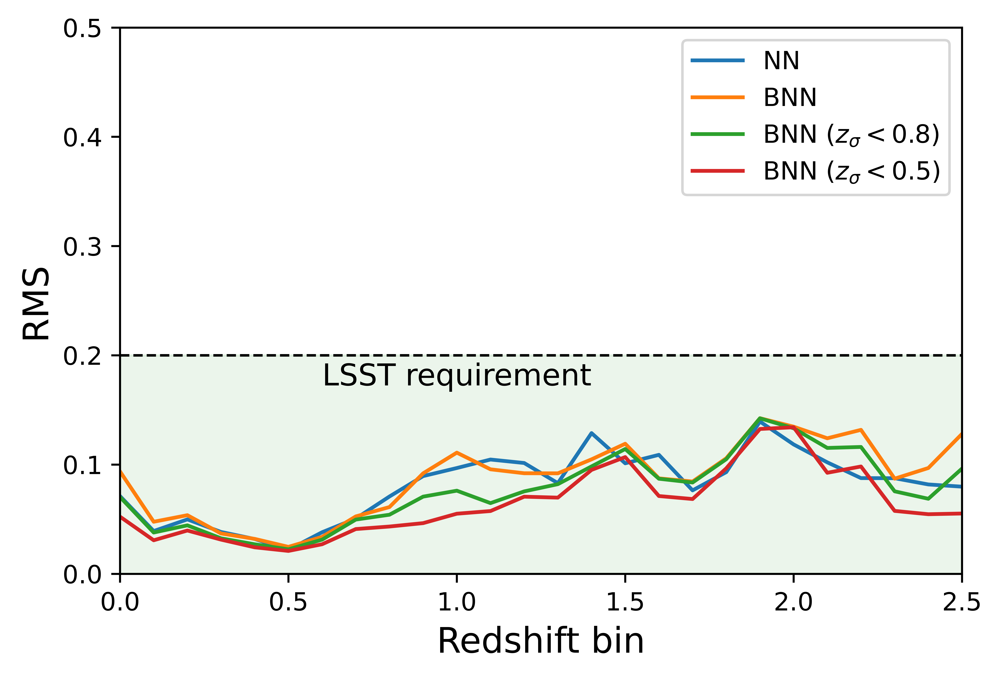

In [381]:

data_cnn = pd.read_csv("/predictions/HSC_v6_CNNTrials_5_pooling_2x2_filters_doubled_v3/testing_predictions_big.csv")
photoz_cnn = data_cnn['photoz']
specz_cnn = data_cnn['specz']

#full bcnn
data_bcnn = pd.read_csv("billy_bcnn_2.csv")
photoz_bcnn = data_bcnn['photoz']
photoz_err_bcnn = data_bcnn['photoz_err']
specz_bcnn = data_bcnn['specz']


data_nn = pd.read_csv("4layers_200_nodes_NN_1.header.csv")
photoz_nn = data_nn['photoz']
photoz_nn = np.array(photoz_nn.str.strip("[]"),dtype='float')
#photoz_err_nn = data_bcnn['photoz_err']
specz_nn = data_nn['spectroz']


data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bnn = np.array(zdelta, dtype='float')

photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz_bnn = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz']
specz_bnn = np.array(zspec)

zcut = 0.8
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma8 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma8 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma8 = photoz_err_bnn[non_cat_outlier_idx]

zcut = 0.5
non_cat_outlier_idx = get_indice_of_non_cat_outliers(photoz_err_bnn,zcut)
photoz_bnn_sigma5 = photoz_bnn[non_cat_outlier_idx]
specz_bnn_sigma5 = specz_bnn[non_cat_outlier_idx]
photoz_err_bnn_sigma5 = photoz_err_bnn[non_cat_outlier_idx]



# #now 3 sigma outliers:

# #Now bias

# #to obtain these plots, plot the average of the curves +- the standard deviation at each bin

#data_bnn = pd.read_csv("4layers_200_nodes.header.csv")

# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# photoz_err_bnn = np.array(zdelta, dtype='float')
# # zcut = 1000
# # non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz_bnn = np.array(photoz, dtype='float')

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# specz_bnn = zspec
# fourlayer_coverage_1 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_1 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('1layers_200_nodes.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000

# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz2 = np.array(photoz, dtype='float')
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest2 = zspec
# fourlayer_coverage_2 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_2 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_3.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz3 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest3 = zspec
# fourlayer_coverage_3 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_3 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_4.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz4 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest4 = zspec
# fourlayer_coverage_4 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_4 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_5.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest5 = zspec
# fourlayer_coverage_5 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_5 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz5 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_6.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest6 = zspec
# fourlayer_coverage_6 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_6 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz6 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_7.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz7 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest7 = zspec
# fourlayer_coverage_7 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_7 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_8.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest8 = zspec
# fourlayer_coverage_8 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_8 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz8 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_9.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz9 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest9 = zspec
# fourlayer_coverage_9 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_9 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_10.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest10 = zspec
# fourlayer_coverage_10 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_10 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz10 = np.array(photoz, dtype='float')


from photoz_utils import *
#ytest_predict = zspec
#z_err = specz_err[idx_test]
#z_err = np.array(prediction_stdv)
#max_z_err = max(z_err)
#ytest = ytest_original
coverage_arr = []
fig, ax = plt.subplots()

biweight_outlier_rate_arr = []
conv_outlier_arr = []
b_bw_arr = []
sigma_bw_arr = []
loss_arr = []
hsc_outlier_arr = []
delta_z_div_z_err_arr = []
median_delta_z_div_z_err_arr = []
# final_per_gal_coverage_1 = np.array(fourlayer_coverage_1/68.27)
# final_per_gal_coverage_2 = np.array(fourlayer_coverage_2/68.27)
# final_per_gal_coverage_3 = np.array(fourlayer_coverage_3/68.27)
# final_per_gal_coverage_4 = np.array(fourlayer_coverage_4/68.27)
# final_per_gal_coverage_5 = np.array(fourlayer_coverage_5/68.27)
# final_per_gal_coverage_6 = np.array(fourlayer_coverage_6/68.27)
# final_per_gal_coverage_7 = np.array(fourlayer_coverage_7/68.27)
# final_per_gal_coverage_8 = np.array(fourlayer_coverage_8/68.27)
# final_per_gal_coverage_9 = np.array(fourlayer_coverage_9/68.27)
# final_per_gal_coverage_10 = np.array(fourlayer_coverage_10/68.27)

coverage_1_arr = []
coverage_2_arr = []
coverage_3_arr = []
coverage_4_arr = []
coverage_5_arr = []
coverage_6_arr = []
coverage_7_arr = []
coverage_8_arr = []
coverage_9_arr = []
coverage_10_arr = []

outlier_1_bnn = []
outlier_1_bnn_sigma8 = []
outlier_1_bnn_sigma5 = []
outlier_1_nn = []

bias_2_arr = []
bias_3_arr = []
bias_4_arr = []
bias_5_arr = []
bias_6_arr = []
bias_7_arr = []
bias_8_arr = []
bias_9_arr = []
bias_10_arr = []

ytest = specz_bcnn

            



            
for i in range(0,26):
    
            filt_bnn = (specz_bnn > i/10.0)\
            & (specz_bnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bnn_i = photoz_bnn[filt_bnn]
            ytest_bnn_i = specz_bnn[filt_bnn]
            outlier_1_bnn.append(calculate_rms(photoz_bnn_i,ytest_bnn_i))

            ytest = specz_bnn
            
for i in range(0,26):
    
            filt_bnn_sigma8 = (specz_bnn_sigma8 > i/10.0)\
            & (specz_bnn_sigma8 < (i+1) / 10.0)

            
            photoz_bnn_sigma8_i = photoz_bnn_sigma8[filt_bnn_sigma8]
            ytest_bnn_sigma8_i = specz_bnn_sigma8[filt_bnn_sigma8]
            photoz_err_bnn_sigma8_i = photoz_err_bnn_sigma8[filt_bnn_sigma8]

            outlier_1_bnn_sigma8.append(calculate_rms(photoz_bnn_sigma8_i,ytest_bnn_sigma8_i,))


for i in range(0,26):
    
            filt_bnn_sigma5 = (specz_bnn_sigma5 > i/10.0)\
            & (specz_bnn_sigma5 < (i+1) / 10.0)

            
            photoz_bnn_sigma5_i = photoz_bnn_sigma5[filt_bnn_sigma5]
            ytest_bnn_sigma5_i = specz_bnn_sigma5[filt_bnn_sigma5]
            photoz_err_bnn_sigma5_i = photoz_err_bnn_sigma5[filt_bnn_sigma5]

            outlier_1_bnn_sigma5.append(calculate_rms(photoz_bnn_sigma5_i,ytest_bnn_sigma5_i,))


for i in range(0,26):
    
            filt_nn = (specz_nn > i/10.0)\
            & (specz_nn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_nn_i = photoz_nn[filt_nn]
            ytest_nn_i = specz_nn[filt_nn]
            outlier_1_nn.append(calculate_rms(photoz_nn_i,ytest_nn_i))

            ytest = specz_nn
            

                
#         if j == 2:
#             filt = (ytest2 > i/10.0)\
#             & (ytest2 < (i+2) / 10.0)
# #             coverage_2 = np.mean(final_per_gal_coverage_2[filt])
# #             coverage_2_arr.append(coverage_2)
#             photoz_i = photoz2[filt]
#             ytest_i = ytest2[filt]
#             bias_2_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
            
            
#         if j == 3:
#             filt = (ytest3 > i/10.0)\
#             & (ytest3 < (i+3) / 10.0)
# #             coverage_3 = np.mean(final_per_gal_coverage_3[filt])
# #             coverage_3_arr.append(coverage_3)
#             photoz_i = photoz3[filt]
#             ytest_i = ytest3[filt]
#             bias_3_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 4:
#             filt = (ytest4 > i/10.0)\
#             & (ytest4 < (i+4) / 10.0)
# #             coverage_4 = np.mean(final_per_gal_coverage_4[filt])
# #             coverage_4_arr.append(coverage_4)
#             photoz_i = photoz4[filt]
#             ytest_i = ytest4[filt]
#             bias_4_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 5:
#             filt = (ytest5 > i/10.0)\
#             & (ytest5 < (i+5) / 10.0)
# #             coverage_5 = np.mean(final_per_gal_coverage_5[filt])
# #             coverage_5_arr.append(coverage_5)
#             photoz_i = photoz5[filt]
#             ytest_i = ytest5[filt]
#             bias_5_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 6:
#             filt = (ytest6 > i/10.0)\
#             & (ytest6 < (i+6) / 10.0)
# #             coverage_6 = np.mean(final_per_gal_coverage_6[filt])
# #             coverage_6_arr.append(coverage_6)
#             photoz_i = photoz6[filt]
#             ytest_i = ytest6[filt]
#             bias_6_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 7:
#             filt = (ytest7 > i/10.0)\
#             & (ytest7 < (i+7) / 10.0)
# #             coverage_7 = np.mean(final_per_gal_coverage_7[filt])
# #             coverage_7_arr.append(coverage_7)   
#             photoz_i = photoz7[filt]
#             ytest_i = ytest7[filt]
#             bias_7_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 8:
#             filt = (ytest8 > i/10.0)\
#             & (ytest8 < (i+8) / 10.0)
# #             coverage_8 = np.mean(final_per_gal_coverage_8[filt])
# #             coverage_8_arr.append(coverage_8)
#             photoz_i = photoz8[filt]
#             ytest_i = ytest8[filt]
#             bias_8_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         #photoz_i = ytest_predict[filt]
#         #ytest_i = ytest[filt]
#         #z_err_i = z_err[filt]


#         if j == 9:
#             filt = (ytest9 > i/10.0)\
#             & (ytest9 < (i+9) / 10.0)
# #             coverage_9 = np.mean(final_per_gal_coverage_9[filt])
# #             coverage_9_arr.append(coverage_9)    
#             photoz_i = photoz9[filt]
#             ytest_i = ytest9[filt]
#             bias_9_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 10:
#             filt = (ytest10 > i/10.0)\
#             & (ytest10 < (i+10) / 10.0)
# #             coverage_10 = np.mean(final_per_gal_coverage_10[filt])
# #             coverage_10_arr.append(coverage_10)
#             photoz_i = photoz10[filt]
#             ytest_i = ytest10[filt]
#             bias_10_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))            
            
      #b_bw = calculate_conv_outlier_rate(photoz_i,ytest_i,fourlayer_zddu_1)
#     sigma_bw = calculate_scatter(photoz_i,ytest_i)
#     outlier_rate = calculate_biweight_outlier_rate(photoz_i,ytest_i,b_bw,sigma_bw)
#     loss_function = calculate_loss(photoz_i,ytest_i)
#     conv_outlier_rate = calculate_conv_outlier_rate(photoz_i,ytest_i)
#     HSC_outlier_rate = calculate_HSC_outlier_rate(photoz_i,ytest_i)
#     delta_z_div_z_err, median_delta_z_div_z_err = calculate_delta_z_div_z_err(photoz_i, ytest_i, z_err_i)
    
#     coverage_2 = np.mean(final_per_gal_coverage_2[filt])
#     coverage_3 = np.mean(final_per_gal_coverage_3[filt])
#     coverage_4 = np.mean(final_per_gal_coverage_4[filt])
#     coverage_5 = np.mean(final_per_gal_coverage_5[filt])
#     coverage_6 = np.mean(final_per_gal_coverage_6[filt])
#     coverage_7 = np.mean(final_per_gal_coverage_7[filt])
#     coverage_8 = np.mean(final_per_gal_coverage_8[filt])
#     coverage_9 = np.mean(final_per_gal_coverage_9[filt])
#     coverage_10 = np.mean(final_per_gal_coverage_10[filt])


#     coverage_4l = np.mean(final_per_gal_coverage_4l[filt])
#     coverage_5l = np.mean(final_per_gal_coverage_5l[filt])

      #b_bw_arr.append(b_bw)
#     conv_outlier_arr.append(conv_outlier_rate)
#     biweight_outlier_rate_arr.append(outlier_rate)
#     sigma_bw_arr.append(sigma_bw)
#     loss_arr.append(loss_function)
#     hsc_outlier_arr.append(HSC_outlier_rate)
#     delta_z_div_z_err_arr.append(delta_z_div_z_err)
#     median_delta_z_div_z_err_arr.append(median_delta_z_div_z_err)
    
#     coverage_2_arr.append(coverage_2)
#     coverage_3_arr.append(coverage_3)
#     coverage_4_arr.append(coverage_4)
#     coverage_5_arr.append(coverage_5)
#     coverage_6_arr.append(coverage_6)
#     coverage_7_arr.append(coverage_7)
#     coverage_8_arr.append(coverage_8)
#     coverage_9_arr.append(coverage_9)
#     coverage_10_arr.append(coverage_10)
#     coverage_4l_arr.append(coverage_4l)
#     coverage_5l_arr.append(coverage_5l)



#     print("bin:", i)
#     print ("bias: %s"%(b_bw))
#     print("scatter: %s"%(sigma_bw))
#     print("biweighht outlier rate: %s"%(outlier_rate))
#     print("conventional outlier rate: %s"%(conv_outlier_rate))
#     print("average loss: %s"%(average_loss))
#     print("HSC outlier rate: %s"%(HSC_outlier_rate))

#delta_z_div_z_err = np.array(delta_z_div_z_err)
#scaled_delta_z_div_z_err = (delta_z_div_z_err_arr-min(delta_z_div_z_err_arr))/(max(delta_z_div_z_err_arr)-min(delta_z_div_z_err_arr))
#scaled_median_delta_z_div_z_err = (median_delta_z_div_z_err_arr-min(median_delta_z_div_z_err_arr))/(max(median_delta_z_div_z_err_arr)-min(median_delta_z_div_z_err_arr))

#sns.set(rc={'figure.figsize':(18,8), 'lines.markersize':10})
bins = [i/10.0 for i in range(26)]
#sns.lineplot(x=[0,4], y=[0,0], linewidth=2, color='black')
#sns.scatterplot(x=bins, y=b_bw_arr, marker = '.', edgecolor='none', label='bias')
#sns.scatterplot(x=bins, y=sigma_bw_arr, marker = "s", facecolors='none', edgecolor='black', label = 'sigma')
#sns.scatterplot(x=bins, y=biweight_outlier_rate_arr, marker = "v", edgecolor='none', label='biweight outlier')
#sns.scatterplot(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='black', label = 'conv outlier')
#sns.scatterplot(x=bins, y=hsc_outlier_arr, marker = "v", facecolors='none', edgecolor='black', label = 'HSC outlier')
#sns.scatterplot(x=bins, y=scaled_delta_z_div_z_err, marker = "+", edgecolor='black', label = 'avg delta z div z_err')
#sns.scatterplot(x=bins, y=scaled_median_delta_z_div_z_err, marker = "v", edgecolor='black', label = 'median delta z div z_err')
#sns.scatterplot(x=bins, y=coverage_arr, marker = "x", edgecolor='black', label = 'average coverage')
#plt.title('12 - 200 nodes')

# means = np.mean((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
# stdvs = np.std((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
#means = bias_1_arr
#means = np.mean((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
#stdvs = np.std((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
                        
#plt.plot(bins, coverage_1l_arr)#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_bcnn, label = 'Billy BCNN')#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, outlier_1_cnn, label = 'CNN')
#plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_nn, label = 'NN')
plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_bnn_sigma8, label = 'BNN ($z_{\sigma} < 0.8$)')
plt.plot(bins, outlier_1_bnn_sigma5, label = 'BNN ($z_{\sigma} < 0.5$)')

#plt.plot(bins, outlier_1_bcnn2, label = 'BCNN with mags')#plt.plot(bins, coverage_3l_arr)#, label = '1L')#, label = 'average coverage')
plt.legend()

plt.xlabel('Redshift bin',fontsize=14)
plt.ylabel('RMS',fontsize=14)

ax.fill_between(bins, 0.2, 0, alpha = 0.08, color = 'green')#, label = 'LSST Requirement')   
plt.axhline(y=0.2, color='black', linestyle='--', linewidth=1)

text_kwargs = dict(ha='center', va='center', fontsize=12, color='black')

plt.text(1.0, 0.18, 'LSST requirement', **text_kwargs)
#plt.title('no cut')
plt.ylim(0,0.5)
plt.xlim(0,2.5)
fig.set_dpi(1200)
# 
plt.show()

In [382]:
len(specz_bnn_sigma5)

26721

In [383]:
len(specz_bnn_sigma8)

27734

In [384]:
len(specz_bnn)

28640

In [385]:
(28640-26721)/28640

0.06700418994413408

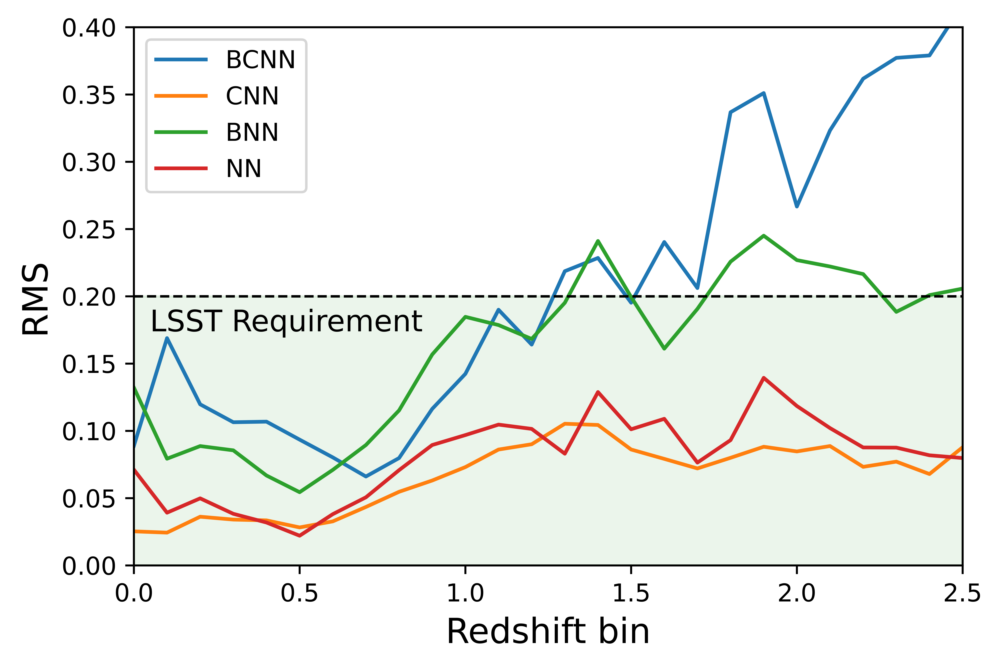

In [380]:
#bias

# #now 3 sigma outliers:

# #Now bias

# #to obtain these plots, plot the average of the curves +- the standard deviation at each bin

#data_bnn = pd.read_csv("4layers_200_nodes.header.csv")

# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# photoz_err_bnn = np.array(zdelta, dtype='float')
# # zcut = 1000
# # non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz_bnn = np.array(photoz, dtype='float')

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# specz_bnn = zspec
# fourlayer_coverage_1 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_1 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# 4layers_200_nodes_NN_1.header.csv
# data_bnn = pd.read_csv('4layers_200_nodes_3.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 10000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz3 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest3 = zspec
# fourlayer_coverage_3 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_3 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_NN_1.header.csv')

# photoz = data_bnn['photoz']
# photoz = photoz.str.strip("[]")
# photoz1 = np.array(photoz, dtype='float')

# zspec = data_bnn['spectroz']
# ytest1 = zspec



data_cnn = pd.read_csv("/predictions/HSC_v6_CNNTrials_5_pooling_2x2_filters_doubled_v3/testing_predictions_big.csv")
photoz_cnn = data_cnn['photoz']
specz_cnn = data_cnn['specz']

#full bcnn
data_bcnn = pd.read_csv("2022_09_22_02_36_34_testing.csv")
photoz_bcnn = data_bcnn['photoz']
photoz_err_bcnn = data_bcnn['photoz_err']
specz_bcnn = data_bcnn['specz']


data_nn = pd.read_csv("4layers_200_nodes_NN_1.header.csv")
photoz_nn = data_nn['photoz']
photoz_nn = np.array(photoz_nn.str.strip("[]"),dtype='float')
#photoz_err_nn = data_bcnn['photoz_err']
specz_nn = data_nn['spectroz']



data_bnn = pd.read_csv("4layers_200_nodes.header.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
photoz_err_bnn = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
photoz = data_bnn['photoz']
photoz = photoz.str.strip("[]")
photoz_bnn = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz']
specz_bnn = zspec


data_cnn2 = pd.read_csv('CNN_10k_1.csv')
photoz_cnn2 = data_cnn2['photoz']
#photoz_cnn2 = photoz.str.strip("[]")
#photoz_cnn2 = np.array(photoz_cnn2, dtype='float')
specz_cnn2 = data_cnn2['specz']

data_bcnn2 = pd.read_csv('bcnn_evan_10k_1.csv')
zdelta = data_bcnn2['photoz_uncertainty']
#zdelta = zdelta.str.strip("[]")
photoz_err_bcnn2 = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
photoz = data_bcnn2['photoz']
photoz = photoz.str.strip("[]")
photoz_bcnn2 = np.array(photoz, dtype='float')

zspec = data_bcnn2['spectroz']
specz_bcnn2 = zspec

# data_bnn = pd.read_csv('1layers_200_nodes.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000

# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz2 = np.array(photoz, dtype='float')
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest2 = zspec
# fourlayer_coverage_2 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_2 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_3.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz3 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest3 = zspec
# fourlayer_coverage_3 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_3 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_4.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz4 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest4 = zspec
# fourlayer_coverage_4 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_4 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_5.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest5 = zspec
# fourlayer_coverage_5 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_5 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz5 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_6.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest6 = zspec
# fourlayer_coverage_6 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_6 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz6 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_7.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz7 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest7 = zspec
# fourlayer_coverage_7 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_7 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]

# data_bnn = pd.read_csv('4layers_200_nodes_8.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest8 = zspec
# fourlayer_coverage_8 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_8 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz8 = np.array(photoz, dtype='float')
# data_bnn = pd.read_csv('4layers_200_nodes_9.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz9 = np.array(photoz, dtype='float')
# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest9 = zspec
# fourlayer_coverage_9 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_9 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]


# data_bnn = pd.read_csv('4layers_200_nodes_10.header.csv')
# zdelta = data_bnn['photoz_uncertainty']
# zdelta = zdelta.str.strip("[]")
# zdelta = np.array(zdelta, dtype='float')
# zcut = 1000
# non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)

# zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
# ytest10 = zspec
# fourlayer_coverage_10 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
# fourlayer_zddu_10 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]
# photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
# photoz = photoz.str.strip("[]")
# photoz10 = np.array(photoz, dtype='float')


from photoz_utils import *
#ytest_predict = zspec
#z_err = specz_err[idx_test]
#z_err = np.array(prediction_stdv)
#max_z_err = max(z_err)
#ytest = ytest_original
coverage_arr = []
fig, ax = plt.subplots()

biweight_outlier_rate_arr = []
conv_outlier_arr = []
b_bw_arr = []
sigma_bw_arr = []
loss_arr = []
hsc_outlier_arr = []
delta_z_div_z_err_arr = []
median_delta_z_div_z_err_arr = []
# final_per_gal_coverage_1 = np.array(fourlayer_coverage_1/68.27)
# final_per_gal_coverage_2 = np.array(fourlayer_coverage_2/68.27)
# final_per_gal_coverage_3 = np.array(fourlayer_coverage_3/68.27)
# final_per_gal_coverage_4 = np.array(fourlayer_coverage_4/68.27)
# final_per_gal_coverage_5 = np.array(fourlayer_coverage_5/68.27)
# final_per_gal_coverage_6 = np.array(fourlayer_coverage_6/68.27)
# final_per_gal_coverage_7 = np.array(fourlayer_coverage_7/68.27)
# final_per_gal_coverage_8 = np.array(fourlayer_coverage_8/68.27)
# final_per_gal_coverage_9 = np.array(fourlayer_coverage_9/68.27)
# final_per_gal_coverage_10 = np.array(fourlayer_coverage_10/68.27)

coverage_1_arr = []
coverage_2_arr = []
coverage_3_arr = []
coverage_4_arr = []
coverage_5_arr = []
coverage_6_arr = []
coverage_7_arr = []
coverage_8_arr = []
coverage_9_arr = []
coverage_10_arr = []

outlier_1_bcnn = []
outlier_1_cnn = []
outlier_1_cnn2 = []
outlier_1_bcnn2 = []
outlier_1_bnn = []
outlier_1_nn = []
bias_2_arr = []
bias_3_arr = []
bias_4_arr = []
bias_5_arr = []
bias_6_arr = []
bias_7_arr = []
bias_8_arr = []
bias_9_arr = []
bias_10_arr = []

ytest = specz_bcnn
for i in range(0,26):
    
            filt_bcnn = (specz_bcnn > i/10.0)\
            & (specz_bcnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bcnn_i = photoz_bcnn[filt_bcnn]
            ytest_bcnn_i = specz_bcnn[filt_bcnn]
            outlier_1_bcnn.append(calculate_rms(photoz_bcnn_i,ytest_bcnn_i))
            
            
            
for i in range(0,26):
    
            filt_cnn = (specz_cnn > i/10.0)\
            & (specz_cnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_cnn_i = photoz_cnn[filt_cnn]
            ytest_cnn_i = specz_cnn[filt_cnn]
            outlier_1_cnn.append(calculate_rms(photoz_cnn_i,ytest_cnn_i))
            
            
for i in range(0,26):
    
            filt_bcnn2 = (specz_bcnn2 > i/10.0)\
            & (specz_bcnn2 < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bcnn2_i = photoz_cnn2[filt_bcnn2]
            ytest_bcnn2_i = specz_cnn2[filt_bcnn2]
            outlier_1_bcnn2.append(calculate_rms(photoz_bcnn2_i,ytest_bcnn2_i))
            
for i in range(0,26):
    
            filt_cnn2 = (specz_cnn2 > i/10.0)\
            & (specz_cnn2 < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_cnn2_i = photoz_cnn2[filt_cnn2]
            ytest_cnn2_i = specz_cnn2[filt_cnn2]
            outlier_1_cnn2.append(calculate_rms(photoz_cnn2_i,ytest_cnn2_i))
            
            
for i in range(0,26):
    
            filt_nn = (specz_nn > i/10.0)\
            & (specz_nn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_nn_i = photoz_nn[filt_nn]
            ytest_nn_i = specz_nn[filt_nn]
            outlier_1_nn.append(calculate_rms(photoz_nn_i,ytest_nn_i))

            
for i in range(0,26):
    
            filt_bnn = (specz_bnn > i/10.0)\
            & (specz_bnn < (i+1) / 10.0)
            
            
#             coverage_1 = np.mean(final_per_gal_coverage_1[filt])
#             coverage_1_arr.append(coverage_1)
            
            photoz_bnn_i = photoz_bnn[filt_bnn]
            ytest_bnn_i = specz_bnn[filt_bnn]
            outlier_1_bnn.append(calculate_rms(photoz_bnn_i,ytest_bnn_i))

                      
#         if j == 2:
#             filt = (ytest2 > i/10.0)\
#             & (ytest2 < (i+2) / 10.0)
# #             coverage_2 = np.mean(final_per_gal_coverage_2[filt])
# #             coverage_2_arr.append(coverage_2)
#             photoz_i = photoz2[filt]
#             ytest_i = ytest2[filt]
#             bias_2_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
            
            
#         if j == 3:
#             filt = (ytest3 > i/10.0)\
#             & (ytest3 < (i+3) / 10.0)
# #             coverage_3 = np.mean(final_per_gal_coverage_3[filt])
# #             coverage_3_arr.append(coverage_3)
#             photoz_i = photoz3[filt]
#             ytest_i = ytest3[filt]
#             bias_3_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 4:
#             filt = (ytest4 > i/10.0)\
#             & (ytest4 < (i+4) / 10.0)
# #             coverage_4 = np.mean(final_per_gal_coverage_4[filt])
# #             coverage_4_arr.append(coverage_4)
#             photoz_i = photoz4[filt]
#             ytest_i = ytest4[filt]
#             bias_4_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 5:
#             filt = (ytest5 > i/10.0)\
#             & (ytest5 < (i+5) / 10.0)
# #             coverage_5 = np.mean(final_per_gal_coverage_5[filt])
# #             coverage_5_arr.append(coverage_5)
#             photoz_i = photoz5[filt]
#             ytest_i = ytest5[filt]
#             bias_5_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         if j == 6:
#             filt = (ytest6 > i/10.0)\
#             & (ytest6 < (i+6) / 10.0)
# #             coverage_6 = np.mean(final_per_gal_coverage_6[filt])
# #             coverage_6_arr.append(coverage_6)
#             photoz_i = photoz6[filt]
#             ytest_i = ytest6[filt]
#             bias_6_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 7:
#             filt = (ytest7 > i/10.0)\
#             & (ytest7 < (i+7) / 10.0)
# #             coverage_7 = np.mean(final_per_gal_coverage_7[filt])
# #             coverage_7_arr.append(coverage_7)   
#             photoz_i = photoz7[filt]
#             ytest_i = ytest7[filt]
#             bias_7_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 8:
#             filt = (ytest8 > i/10.0)\
#             & (ytest8 < (i+8) / 10.0)
# #             coverage_8 = np.mean(final_per_gal_coverage_8[filt])
# #             coverage_8_arr.append(coverage_8)
#             photoz_i = photoz8[filt]
#             ytest_i = ytest8[filt]
#             bias_8_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))
#         #photoz_i = ytest_predict[filt]
#         #ytest_i = ytest[filt]
#         #z_err_i = z_err[filt]


#         if j == 9:
#             filt = (ytest9 > i/10.0)\
#             & (ytest9 < (i+9) / 10.0)
# #             coverage_9 = np.mean(final_per_gal_coverage_9[filt])
# #             coverage_9_arr.append(coverage_9)    
#             photoz_i = photoz9[filt]
#             ytest_i = ytest9[filt]
#             bias_9_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))

#         if j == 10:
#             filt = (ytest10 > i/10.0)\
#             & (ytest10 < (i+10) / 10.0)
# #             coverage_10 = np.mean(final_per_gal_coverage_10[filt])
# #             coverage_10_arr.append(coverage_10)
#             photoz_i = photoz10[filt]
#             ytest_i = ytest10[filt]
#             bias_10_arr.append(calculate_conv_outlier_rate(photoz_i,ytest_i))            
            
      #b_bw = calculate_conv_outlier_rate(photoz_i,ytest_i,fourlayer_zddu_1)
#     sigma_bw = calculate_scatter(photoz_i,ytest_i)
#     outlier_rate = calculate_biweight_outlier_rate(photoz_i,ytest_i,b_bw,sigma_bw)
#     loss_function = calculate_loss(photoz_i,ytest_i)
#     conv_outlier_rate = calculate_conv_outlier_rate(photoz_i,ytest_i)
#     HSC_outlier_rate = calculate_HSC_outlier_rate(photoz_i,ytest_i)
#     delta_z_div_z_err, median_delta_z_div_z_err = calculate_delta_z_div_z_err(photoz_i, ytest_i, z_err_i)
    
#     coverage_2 = np.mean(final_per_gal_coverage_2[filt])
#     coverage_3 = np.mean(final_per_gal_coverage_3[filt])
#     coverage_4 = np.mean(final_per_gal_coverage_4[filt])
#     coverage_5 = np.mean(final_per_gal_coverage_5[filt])
#     coverage_6 = np.mean(final_per_gal_coverage_6[filt])
#     coverage_7 = np.mean(final_per_gal_coverage_7[filt])
#     coverage_8 = np.mean(final_per_gal_coverage_8[filt])
#     coverage_9 = np.mean(final_per_gal_coverage_9[filt])
#     coverage_10 = np.mean(final_per_gal_coverage_10[filt])


#     coverage_4l = np.mean(final_per_gal_coverage_4l[filt])
#     coverage_5l = np.mean(final_per_gal_coverage_5l[filt])

      #b_bw_arr.append(b_bw)
#     conv_outlier_arr.append(conv_outlier_rate)
#     biweight_outlier_rate_arr.append(outlier_rate)
#     sigma_bw_arr.append(sigma_bw)
#     loss_arr.append(loss_function)
#     hsc_outlier_arr.append(HSC_outlier_rate)
#     delta_z_div_z_err_arr.append(delta_z_div_z_err)
#     median_delta_z_div_z_err_arr.append(median_delta_z_div_z_err)
    
#     coverage_2_arr.append(coverage_2)
#     coverage_3_arr.append(coverage_3)
#     coverage_4_arr.append(coverage_4)
#     coverage_5_arr.append(coverage_5)
#     coverage_6_arr.append(coverage_6)
#     coverage_7_arr.append(coverage_7)
#     coverage_8_arr.append(coverage_8)
#     coverage_9_arr.append(coverage_9)
#     coverage_10_arr.append(coverage_10)
#     coverage_4l_arr.append(coverage_4l)
#     coverage_5l_arr.append(coverage_5l)



#     print("bin:", i)
#     print ("bias: %s"%(b_bw))
#     print("scatter: %s"%(sigma_bw))
#     print("biweighht outlier rate: %s"%(outlier_rate))
#     print("conventional outlier rate: %s"%(conv_outlier_rate))
#     print("average loss: %s"%(average_loss))
#     print("HSC outlier rate: %s"%(HSC_outlier_rate))

#delta_z_div_z_err = np.array(delta_z_div_z_err)
#scaled_delta_z_div_z_err = (delta_z_div_z_err_arr-min(delta_z_div_z_err_arr))/(max(delta_z_div_z_err_arr)-min(delta_z_div_z_err_arr))
#scaled_median_delta_z_div_z_err = (median_delta_z_div_z_err_arr-min(median_delta_z_div_z_err_arr))/(max(median_delta_z_div_z_err_arr)-min(median_delta_z_div_z_err_arr))

#sns.set(rc={'figure.figsize':(18,8), 'lines.markersize':10})
bins = [i/10.0 for i in range(26)]
#sns.lineplot(x=[0,4], y=[0,0], linewidth=2, color='black')
#sns.scatterplot(x=bins, y=b_bw_arr, marker = '.', edgecolor='none', label='bias')
#sns.scatterplot(x=bins, y=sigma_bw_arr, marker = "s", facecolors='none', edgecolor='black', label = 'sigma')
#sns.scatterplot(x=bins, y=biweight_outlier_rate_arr, marker = "v", edgecolor='none', label='biweight outlier')
#sns.scatterplot(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='black', label = 'conv outlier')
#sns.scatterplot(x=bins, y=hsc_outlier_arr, marker = "v", facecolors='none', edgecolor='black', label = 'HSC outlier')
#sns.scatterplot(x=bins, y=scaled_delta_z_div_z_err, marker = "+", edgecolor='black', label = 'avg delta z div z_err')
#sns.scatterplot(x=bins, y=scaled_median_delta_z_div_z_err, marker = "v", edgecolor='black', label = 'median delta z div z_err')
#sns.scatterplot(x=bins, y=coverage_arr, marker = "x", edgecolor='black', label = 'average coverage')
#plt.title('12 - 200 nodes')

# means = np.mean((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)
# stdvs = np.std((coverage_1_arr,coverage_2_arr,coverage_3_arr,coverage_4_arr,coverage_5_arr,coverage_6_arr,coverage_7_arr,coverage_8_arr,coverage_9_arr,coverage_10_arr),axis=0)

#means = np.mean((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
#stdvs = np.std((bias_1_arr,bias_2_arr,bias_3_arr,bias_4_arr,bias_5_arr,bias_6_arr,bias_7_arr,bias_8_arr,bias_9_arr,bias_10_arr),axis=0)
                        
#plt.plot(bins, coverage_1l_arr)#, label = '1L')#, label = 'average coverage')
plt.plot(bins, outlier_1_bcnn, label = 'BCNN')#, label = '1L')#, label = 'average coverage')
plt.plot(bins, outlier_1_cnn, label = 'CNN')
#plt.plot(bins, outlier_1_cnn2, label = 'Evan CNN with mags')
#plt.plot(bins, outlier_1_bcnn2, label = 'Evan BCNN')
plt.plot(bins, outlier_1_bnn, label = 'BNN')
plt.plot(bins, outlier_1_nn, label = 'NN')#plt.plot(bins, coverage_3l_arr)#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, coverage_4l_arr)#, label = '1L')#, label = 'average coverage')
#plt.plot(bins, coverage_5l_arr)#, label = '1L')#, label = 'average coverage')
# y_l = means-stdvs
# y_u = means+stdvs
# ax.fill_between(bins, y_l, y_u, alpha=0.3)#, edgecolor=clr, facecolor=clr)

# plt.plot(bins, means22, label = 'NN')#, label = '1L')#, label = 'average coverage')
# #plt.plot(bins, coverage_3l_arr)#, label = '1L')#, label = 'average coverage')
# #plt.plot(bins, coverage_4l_arr)#, label = '1L')#, label = 'average coverage')
# #plt.plot(bins, coverage_5l_arr)#, label = '1L')#, label = 'average coverage')
# y_l = means22-stdvs22
# y_u = means22+stdvs22
# ax.fill_between(bins, y_l, y_u, alpha=0.3)#, edgecolor=clr, facecolor=clr)

# # plt.scatter(x=bins, y=coverage_1l_arr, marker = "o", edgecolor='none', s=5, label = '1L')#, label = 'average coverage')
# # plt.scatter(x=bins, y=coverage_2l_arr, marker = "o", edgecolor='none', s=5, label = '2L')#, label = 'average coverage')
# # plt.scatter(x=bins, y=coverage_3l_arr, marker = "o", edgecolor='none', s=5, label = '3L')#, label = 'average coverage')
# #plt.scatter(x=bins, y=coverage_4l_arr, marker = "o", edgecolor='none', s=5, label = '4L')#, label = 'average coverage')
# #plt.scatter(x=bins, y=coverage_5l_arr, marker = "o", edgecolor='none', s=5, label = '5L')#, label = 'average coverage')
plt.legend()
#plt.scatter(x=bins, y=coverage_arr, marker = "o", edgecolor='none', s=5, label = '1L')#, label = 'average coverage')

#plt.axhline(y=0.10, color='black', linestyle='--', linewidth=1)
#plt.axhline(y=-0.003, color='black', linestyle='--', linewidth=1)

# text_kwargs = dict(ha='center', va='center', fontsize=12, color='black')
# #plt.subplots(figsize=(6, 2))
# plt.text(1.6, 0.935, 'underestimated $z_{\sigma}$', **text_kwargs)
# #plt.legend()
#plt.text(2.05, 0.09, 'LSST Requirement', **text_kwargs)
#sns.scatterplot(x=bins, y=loss_arr, marker = 'x', label = "loss", linewidth=4)
plt.xlabel('Redshift bin',fontsize=14)
plt.ylabel('RMS',fontsize=14)
#plt.title('no cut')
plt.ylim(0,0.4)
plt.xlim(0,2.5)
plt.axhline(y=0.2, color='black', linestyle='--', linewidth=1)

text_kwargs = dict(ha='center', va='center', fontsize=12, color='black')
#plt.subplots(figsize=(6, 2))
plt.text(0.46, 0.18, 'LSST Requirement', **text_kwargs)
#plt.ylim(-.1,0.05)
fig.set_dpi(1200)
# 
ax.fill_between(bins, 0,0.2, alpha = 0.08, color = 'green')      

plt.show()

# figure 9

In [ ]:
\begin{figure}[!tbp]
  \centering
  \begin{minipage}[b]{\textwidth}
    \includegraphics[width=\textwidth]{point05.png}
    %\caption{Visualization of photo-z performance }
  \end{minipage}
  \hfill
  \begin{minipage}[b]{\textwidth}
    \includegraphics[width=\textwidth]{z_392.png}
    %\caption{Flower two.}
  \end{minipage}
  \hfill
  \begin{minipage}[b]{\textwidth}
    \includegraphics[width=\textwidth]{point14.png}
    %\caption{Flower two.}
  \end{minipage}
  \hfill
 \caption{Example HSC galaxy images with grizy photometry for a low redshift galaxy at $z = 0.05$ (TOP), and a high redshift galaxy at $z = 3.92$ (MIDDLE), and another low redshift galaxy at $z = 0.14$. The similarity between the high redshift galaxy and the bottom low redshift galaxy highlights the difficulty of photo-z estimation.}
\end{figure}

# figure 10
FROM https://aurora.astro.ucla.edu/user/ejones/notebooks/PIT-calibration.ipynb


In [349]:
#goal: after removal of gals with z_delta > 0.5, get indice of remaining:
def get_indice_of_non_cat_outliers(zdelta,zcut):
    
    non_cat_outlier_idx = np.where(zdelta < zcut)
    
    return non_cat_outlier_idx



data_bnn = pd.read_csv("bnn_v5_best.csv")

zdelta = data_bnn['photoz_uncertainty']
zdelta = zdelta.str.strip("[]")
zdelta = np.array(zdelta, dtype='float')
zcut = 0.8

non_cat_outlier_idx = get_indice_of_non_cat_outliers(zdelta,zcut)
zdelta = zdelta[non_cat_outlier_idx]
photoz = data_bnn['photoz'].iloc[non_cat_outlier_idx]
photoz = photoz.str.strip("[]")
photoz1 = np.array(photoz, dtype='float')

zspec = data_bnn['spectroz'].iloc[non_cat_outlier_idx]
ytest1 = np.array(zspec)
fourlayer_coverage_1 = data_bnn["coverage"].iloc[non_cat_outlier_idx]
fourlayer_zddu_1 = data_bnn["z_delta_div_uncertainty_list"].iloc[non_cat_outlier_idx]




def calculate_PIT(predictions,uncertainty, true_value):

# predictions is a two dimentional array. Each row is a PDF for the estimation of redshift for a galaxy. 
# y_test is an array containing the true_value of redshift for all the galaxies. 
# the ouput of this function is a PIT distribution for all the PDFs. 

    PIT  = []
    
    for i in range (0,len(predictions)):   
        pdf = []
        for j in range(0,1000):
            pdf.append(np.random.normal(loc=predictions[i], scale=uncertainty[i], size=None))
            
        
        PIT.append(len(np.where(pdf<true_value[i])[0])*1.0/len(pdf))
#         plt.hist(pdf)
#         print(len(pdf))
#         print(true_value[i])
#         print(len(np.where(pdf<true_value[i])))
    return PIT

pit1000 = calculate_PIT(photoz1,zdelta,ytest1)



Text(0.5, 0, 'PIT value')

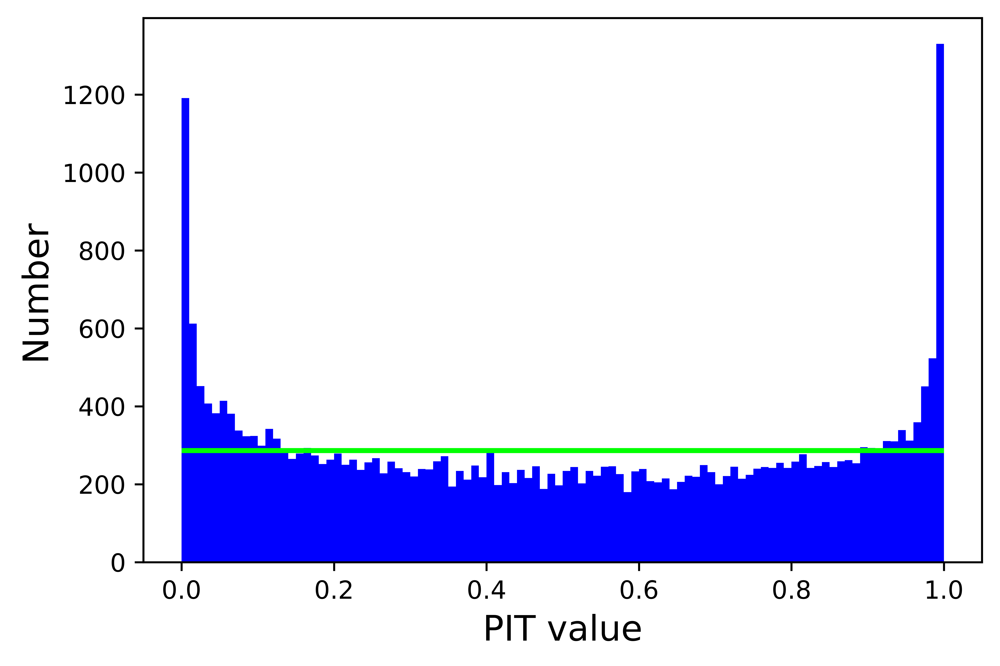

In [3]:
fig, ax = plt.subplots()
fig.set_dpi(1200)
pit1000_plot = plt.hist(np.array(pit1000),100, color='blue')
plt.hlines(y=sum(pit1000_plot[0]/100), xmin=0, xmax=1.0, linewidth=2, color='lime')
plt.ylabel('Number',fontsize=14)
plt.xlabel('PIT value',fontsize=14)


Text(0.5, 0, 'PIT value')

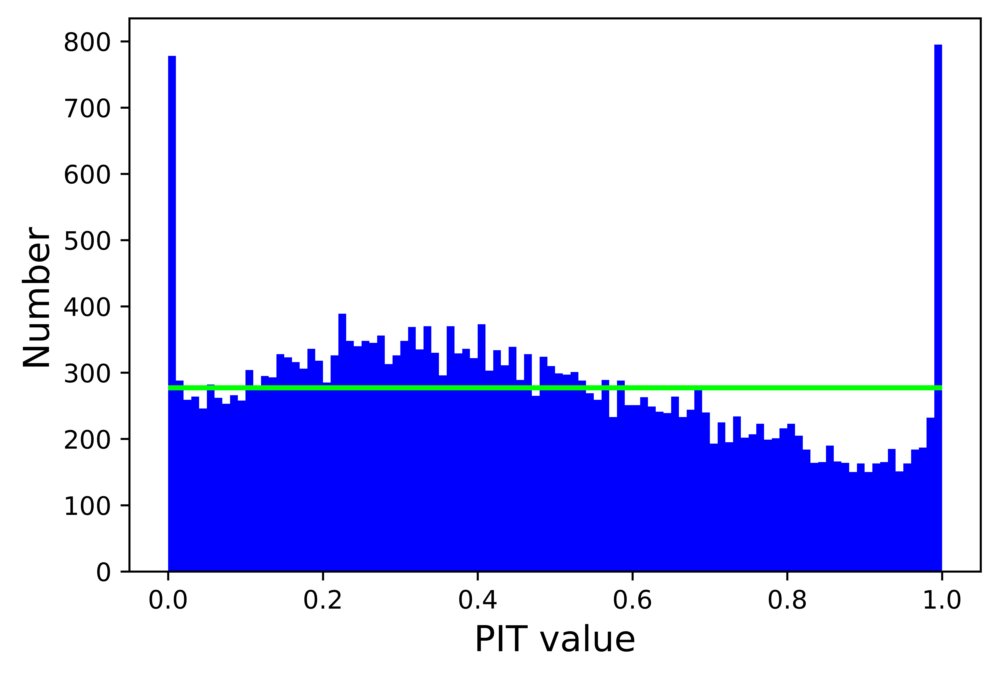

In [350]:
fig, ax = plt.subplots()
fig.set_dpi(1200)
pit1000_plot = plt.hist(np.array(pit1000),100, color='blue')
plt.hlines(y=sum(pit1000_plot[0]/100), xmin=0, xmax=1.0, linewidth=2, color='lime')
plt.ylabel('Number',fontsize=14)
plt.xlabel('PIT value',fontsize=14)


Text(0.5, 0, 'PIT value')

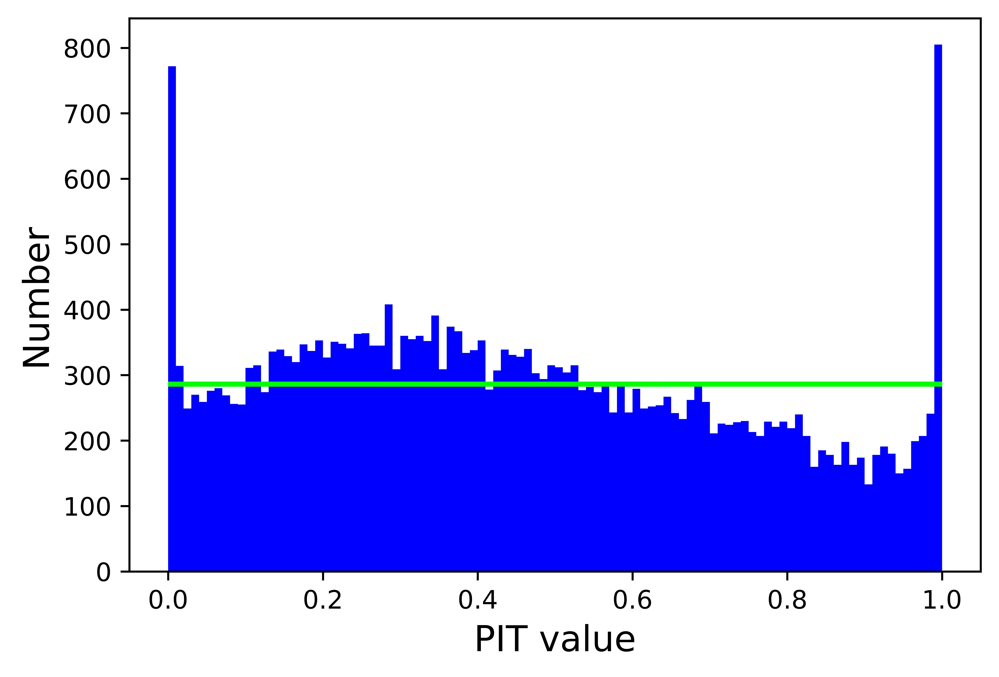

In [347]:
fig, ax = plt.subplots()
fig.set_dpi(1200)
pit1000_plot = plt.hist(np.array(pit1000),100, color='blue')
plt.hlines(y=sum(pit1000_plot[0]/100), xmin=0, xmax=1.0, linewidth=2, color='lime')
plt.ylabel('Number',fontsize=14)
plt.xlabel('PIT value',fontsize=14)


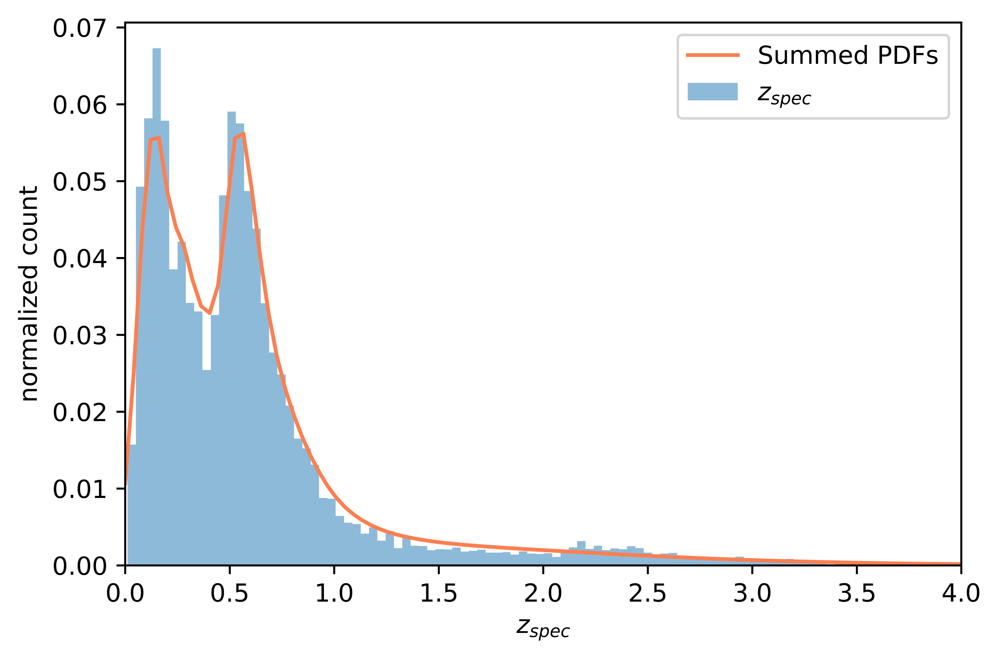

In [5]:
import scipy.stats

#if we don't constrain P(z < 0) = 0
#x = np.linspace(photoz1[0] - 2, photoz1[0] + 2, 1000)
#x = np.linspace(0, 4, 1000)
df_list = []
pdf_arr = []
for i in range(0,len(photoz1)):

    #using P(z < 0) = 0:
    x = np.linspace(0, 4, 100)
    y = scipy.stats.norm.pdf(x,photoz1[i],zdelta[i])
    pdf_arr.append(y)
#a = plt.hist(y,100)

#plt.plot(x,y, color='coral')

#plt.grid()
fig, ax = plt.subplots()
plt.plot(x,sum(pdf_arr)/sum(sum(pdf_arr)), color='coral', label = "Summed PDFs")
#weights = np.ones_like(long_arr_ranged)/len(long_arr_ranged)
#plt.hist(long_arr_ranged, 100,color='coral', weights = weights,label = "Summed PDFs", alpha=0.5)
weights = np.ones_like(ytest1)/len(ytest1)
plt.hist(ytest1,100,weights = weights, label = '$z_{spec}$',alpha=0.5)
plt.legend()
plt.xlabel('$z_{spec}$')
plt.ylabel('normalized count')
plt.xlim(0,4)
fig.set_dpi(1200)
#plt.grid()

# FIGURE 11 - COMPARISON TO ALL MODELS

FROM https://aurora.astro.ucla.edu/user/ejones/notebooks/compare%20layers-outliers_bar_chart%20-%20non-bayesian%20LSST%20plots.ipynb

# FIGURE 12 - 5 stack plot
https://aurora.astro.ucla.edu/user/ejones/notebooks/v14_4_layers_400_nodes_example_notebook_hparam-gridsearch.ipynb

In [ ]:
fig3 = plt.figure(constrained_layout=True)
gs = fig3.add_gridspec(14, 12)
f3_ax1 = fig3.add_subplot(gs[0:6, 0:6])
#f3_ax1 = ax.scatter(x,y, marker='+', c = z,s=1, norm=matplotlib.colors.LogNorm())
#f3_ax1.scatter(x,y, marker='+', c = z,s=1, norm=matplotlib.colors.LogNorm())
#f3_ax1.set_title('gs[0:6,0:6]')
f3_ax1.set(xticks=[0,1,2,3,4])
f3_ax1.set_title('Bayesian', fontsize = 9)
f3_ax1.scatter(x=bins, y=b_bw_arr, marker = '.',  edgecolor = 'black', label='bias',s = 2)
f3_ax1.scatter(x=bins, y=sigma_bw_arr, marker = "^", facecolors='none', edgecolor='blue', label = r'$\sigma$', s = 2)
f3_ax1.scatter(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='red', label = 'outliers', s = 2)
f3_ax1.legend(prop={'size': 6})
f3_ax1.set_xlabel('$z_{spec}$',fontsize=9)
f3_ax1.set_ylabel('metrics',fontsize=9)
f3_ax1.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
f3_ax1.tick_params(axis='both',which='major',labelsize=6)
f3_ax1.tick_params(axis='both',which='minor',labelsize=4)
f3_ax2 = fig3.add_subplot(gs[0:6, 6:])
f3_ax2.set(xticks=[0,1,2,3,4])
f3_ax2.set_title('non-Bayesian', fontsize = 9)
f3_ax2.set_ylabel('metrics',fontsize=9)
f3_ax2.scatter(x=bins, y=b_bw_arr, marker = '.',  edgecolor = 'black', label='bias',s = 2)
f3_ax2.scatter(x=bins, y=sigma_bw_arr, marker = "^", facecolors='none', edgecolor='blue', label = r'$\sigma$', s = 2)
f3_ax2.scatter(x=bins, y=conv_outlier_arr, marker = "o", facecolors='none', edgecolor='red', label = 'outliers', s = 2)
f3_ax2.legend(prop={'size': 6})
f3_ax2.set_xlabel('$z_{spec}$',fontsize=9)
f3_ax2.set(xticks=[0,1,2,3,4],yticks=[-.8,-.6,-.4,-.2,0,.2,.4,0.6,0.8])
f3_ax2.tick_params(axis='both',which='major',labelsize=6)
f3_ax2.tick_params(axis='both',which='minor',labelsize=4)
##################################################bottom left figure
f3_ax3 = fig3.add_subplot(gs[6:12,0:4])
f3_ax3.scatter(x=bins, y=mean_stdv_per_gal_after_500_determinations_div_1_plus_z_spec_arr, marker = "o", edgecolor='none', s = 5)#, label = 'mean $\sigma$/(1+z_{spec})')
f3_ax3.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax3.set(xticks=[0,1,2,3,4],yticks=[0,0.1,0.2,0.3])
f3_ax3.tick_params(axis='both',which='major',labelsize=6)
f3_ax3.tick_params(axis='both',which='minor',labelsize=4)
f3_ax3.set_ylabel('$\sigma/(1+z_{spec}$)',fontsize=9)
#f3_ax3.set_title('Coverage',fontsize=10)
#################################################bottom middle figure
f3_ax4 = fig3.add_subplot(gs[6:12, 4:8])
#bottom middle figure
#f3_ax4 = fig3.add_subplot(gs[12:24, 8:16])

f3_ax4.scatter(x=bins, y=coverage_arr, marker = "o", edgecolor='none', s=5)#, label = 'average coverage')
f3_ax4.axhline(y=1.0, color='black', linestyle='--', linewidth=1)
text_kwargs = dict(ha='center', va='center', fontsize=6, color='black')
#plt.subplots(figsize=(6, 2))
f3_ax4.text(1.6, 0.935, 'underestimated $\sigma$', **text_kwargs)

f3_ax4.text(1.6, 1.065, 'overestimated $\sigma$', **text_kwargs)
#plt.show()
#plt.title('13 - 200 nodes')
#sns.scatterplot(x=bins, y=loss_arr, marker = 'x', label = "loss", linewidth=4)
#plt.ylabel('Coverage')
f3_ax4.set_xlabel('$z_{spec}$',fontsize=9)
f3_ax4.set(xticks=[0,1,2,3,4],yticks=[0,0.2,0.4,0.6,0.8,1,1.2])
f3_ax4.tick_params(axis='both',which='major',labelsize=6)
f3_ax4.tick_params(axis='both',which='minor',labelsize=4)
f3_ax4.set_ylabel('coverage',fontsize=9)



#f3_ax4.set_title('Coverage',fontsize=10)

######################################################bottom right figure
f3_ax5 = fig3.add_subplot(gs[6:12, 8:])

f3_ax5.scatter(x=bins, y=conv_outlier_arr, marker = "o", edgecolor='none', label = 'O',s=5)
#sns.scatterplot(x=bins, y=hsc_outlier_arr, marker = "v", facecolors='none', edgecolor='black', label = 'HSC outlier')
#sns.scatterplot(x=bins, y=scaled_delta_z_div_z_err, marker = "+", edgecolor='black', label = 'avg delta z div z_err')
#sns.scatterplot(x=bins, y=scaled_median_delta_z_div_z_err, marker = "v", edgecolor='black', label = 'median delta z div z_err')

f3_ax5.scatter(x=bins, y=bayesian_outlier_arr, marker = ">", edgecolor='none', label = '$O_b$', s=5)
#sns.scatterplot(x=bins, y=z_diff_div_phot_err_arr, marker = "<", edgecolor='black', label = '|zphot-zspec|/zphot_err')
#plt.title('8 - 200 nodes')
#sns.scatterplot(x=bins, y=loss_arr, marker = 'x', label = "loss", linewidth=4)
f3_ax5.set_xlabel('$z_{spec}$',fontsize=8)
f3_ax5.set(xticks=[0,1,2,3,4])#,yticks=[0,20,40,60,80,100])
f3_ax5.tick_params(axis='both',which='major',labelsize=6)
f3_ax5.tick_params(axis='both',which='minor',labelsize=4)
f3_ax5.set_ylabel('outlier %',fontsize=8)
f3_ax5.legend(prop={'size': 6})
#sns.scatterplot(x=bins, y=bayesian_outlier_arr, marker = ">", edgecolor='black', label = 'bayesian outlier')
#sns.scatterplot(x=bins, y=z_diff_div_phot_err_arr, marker = "<", edgecolor='black', label = '|zphot-zspec|/zphot_err')
#f3_ax5.set_title('Bayesian')
#sns.scatterplot(x=bins, y=loss_arr, marker = 'x', label = "loss", linewidth=4)
#f3_ax5.set_xlabel('$z_{spec}$')
#f3_ax5.set_ylabel('Metrics')
fig3.set_dpi(1200)